# Task 1 - 

# Outline
- [ 1 - Data Preprocessing/Filtering](#1)
- [ 2 - Data Visualization ](#2)
- [ 3 - Implementing K-means](#3)
  - [ 3.1 Finding closest centroids](#3.1)
  - [ 3.2 Computing centroid means](#3.2)
  - [ 3.3 Random Initialization for running $K$-Means](#3.3))
  - [ 3.4  Plot Vizualization after Iterations](#3.4)
     - [3.4.1 `draw_line` implementation](#3.4.1)
      - [3.4.2 `plot_data_with_centroids` implementation](#3.4.2)
      - [3.4.3 `plot_progress_kMeans_m` implementation](#3.4.3)
  - [ 3.5- K-means on given datasete](#3.5)
  - [3.6 -  Running $K$-Means Clustering on the filtered dataset](#3.6)
  - [3.7 - Evaluating Cluster Results](#3.7)
- [4 - Observations](#4)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
import seaborn as sns
import geopandas as gpd
from shapely.geometry import Point

sns.set_style('whitegrid')

In [3]:
!pip install geopy

In [4]:
data_path = 'clustering_data.csv'
data = pd.read_csv(data_path)

C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\3827252502.py:2: DtypeWarning: Columns (9) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv(data_path)


<a name="1"></a>
## 1.Data Preprocessing/Filtering
The data has been filtered according to the home state (Karnataka) and all the rows in which There are missing values for Latitude and Longitude columns have been removed and stared in dataframe data_f

In [5]:
data_k = data[(data.StateName == 'KARNATAKA')]

In [6]:
data_k.dropna(subset = ['Latitude','Longitude'])

,CircleName,RegionName,DivisionName,OfficeName,Pincode,OfficeType,Delivery,District,StateName,Latitude,Longitude
429,Karnataka Circle,North Karnataka Region,Bidar Division,MANHALLI S.O,585447,PO,Delivery,BIDAR,KARNATAKA,17.8155,76.7971
430,Karnataka Circle,North Karnataka Region,Bidar Division,Aliabad B.O,585404,BO,Delivery,BIDAR,KARNATAKA,17.6258,78.5955
1202,Karnataka Circle,South Karnataka Region,Mangaluru Division,Bajal S.O,575009,PO,Delivery,DAKSHINA KANNADA,KARNATAKA,12.853372,74.878526
9790,Karnataka Circle,South Karnataka Region,Hassan Division,Aggunda B.O,573103,BO,Delivery,HASSAN,KARNATAKA,13.32,76.27
9791,Karnataka Circle,South Karnataka Region,Hassan Division,Amaragiri Tirupathi B.O,573103,BO,Delivery,HASSAN,KARNATAKA,13.33,76.27
...,...,...,...,...,...,...,...,...,...,...,...
156499,Karnataka Circle,North Karnataka Region,Dharwad Division,Hubballi Bengeri S.O,580023,PO,Non Delivery,DHARWAD,KARNATAKA,15.369069,75.1457373
156500,Karnataka Circle,North Karnataka Region,Dharwad Division,Hubballi Eng College S.O,580031,PO,Delivery,DHARWAD,KARNATAKA,15.368268,75.1228692
156501,Karnataka Circle,North Karnataka Region,Dharwad Division,Hubballi Keshwapur S.O,580023,PO,Delivery,DHARWAD,KARNATAKA,15.36191,75.1514951
156502,Karnataka Circle,North Karnataka Region,Dharwad Division,Hubballi Sarafkatta S.O,580020,PO,Non Delivery,DHARWAD,KARNATAKA,15.340767,75.143347


In [7]:
data_k_nd = data_k.dropna(subset = ['Latitude','Longitude'])

In [8]:
null_df = data_k_nd.isnull()
null_df

,CircleName,RegionName,DivisionName,OfficeName,Pincode,OfficeType,Delivery,District,StateName,Latitude,Longitude
429,False,False,False,False,False,False,False,False,False,False,False
430,False,False,False,False,False,False,False,False,False,False,False
1202,False,False,False,False,False,False,False,False,False,False,False
9790,False,False,False,False,False,False,False,False,False,False,False
9791,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...
156499,False,False,False,False,False,False,False,False,False,False,False
156500,False,False,False,False,False,False,False,False,False,False,False
156501,False,False,False,False,False,False,False,False,False,False,False
156502,False,False,False,False,False,False,False,False,False,False,False


In [9]:
#Confirming there are no null values in data_k_nd['Latitude']
filt = null_df['Latitude'] == True 
null_df[filt]

,CircleName,RegionName,DivisionName,OfficeName,Pincode,OfficeType,Delivery,District,StateName,Latitude,Longitude


In [10]:
#Confirming there are no null values in data_k_nd['Longitude']
filt1 = null_df['Longitude'] == True
null_df[filt1]

,CircleName,RegionName,DivisionName,OfficeName,Pincode,OfficeType,Delivery,District,StateName,Latitude,Longitude


In [11]:
#Confirming there are no null values in data_k_nd["StateName"]
filt2 = null_df['StateName'] == True
null_df[filt2]

,CircleName,RegionName,DivisionName,OfficeName,Pincode,OfficeType,Delivery,District,StateName,Latitude,Longitude


In [12]:
X = data_k_nd.drop(['CircleName', 'RegionName', 'DivisionName', 'OfficeName', 'Pincode',
       'OfficeType', 'Delivery', 'District'],axis = 'columns')

In [13]:
filt6 = X['Latitude'] == 'NA'
X[filt6]

,StateName,Latitude,Longitude


In [14]:
X

,StateName,Latitude,Longitude
429,KARNATAKA,17.8155,76.7971
430,KARNATAKA,17.6258,78.5955
1202,KARNATAKA,12.853372,74.878526
9790,KARNATAKA,13.32,76.27
9791,KARNATAKA,13.33,76.27
...,...,...,...
156499,KARNATAKA,15.369069,75.1457373
156500,KARNATAKA,15.368268,75.1228692
156501,KARNATAKA,15.36191,75.1514951
156502,KARNATAKA,15.340767,75.143347


In [15]:
lo = list(X['Longitude'])

In [16]:
print(f'Check for missings')
for c in X.columns:
    count = X[c].isnull().sum()
    print(f'Col {c} has {count} missing values')
print(f'Done checking for missings')

Check for missings
Col StateName has 0 missing values
Col Latitude has 0 missing values
Col Longitude has 0 missing values
Done checking for missings


In [17]:
filt3 = X['Latitude'].str.contains('-',na=False)
X[filt3]

,StateName,Latitude,Longitude
20927,KARNATAKA,31.4398200-,150.536174


In [18]:
filt4 = X['Longitude'].str.contains('-',na=False)
X[filt4]

,StateName,Latitude,Longitude
19962,KARNATAKA,40.739599,73.9883650-
20200,KARNATAKA,44.972014,84.0283920-
20311,KARNATAKA,52.699568,8.8119230-
20704,KARNATAKA,32.220992,110.9323800-
21127,KARNATAKA,26.031887,80.1914480-
21136,KARNATAKA,20.242068,155.8850500-
53709,KARNATAKA,48.42052,119.5246600-
151907,KARNATAKA,40.465292,74.2652010-


In [19]:
filt5 = (X['Latitude'].str.contains('-',na=False)) | (X['Longitude'].str.contains('-',na=False))
X[filt5]

,StateName,Latitude,Longitude
19962,KARNATAKA,40.739599,73.9883650-
20200,KARNATAKA,44.972014,84.0283920-
20311,KARNATAKA,52.699568,8.8119230-
20704,KARNATAKA,32.220992,110.9323800-
20927,KARNATAKA,31.4398200-,150.536174
21127,KARNATAKA,26.031887,80.1914480-
21136,KARNATAKA,20.242068,155.8850500-
53709,KARNATAKA,48.42052,119.5246600-
151907,KARNATAKA,40.465292,74.2652010-


In [20]:
X_hyp_rem = X[~filt5]

In [21]:
print(f'Check for missings')
for c in X_hyp_rem.columns:
    count = X_hyp_rem[c].isnull().sum()
    print(f'Col {c} has {count} missing values')
print(f'Done checking for missings')

Check for missings
Col StateName has 0 missing values
Col Latitude has 0 missing values
Col Longitude has 0 missing values
Done checking for missings


In [22]:
data_k_nd_hyp_rem = data_k_nd[~filt5]

<a name="2"></a>
## 2.Data Visualization

In [23]:
fp = r'Districts shape file\Census_2011\2011_Dist.shp'
karnataka_df = gpd.read_file(fp)
karnataka_df .head()

,DISTRICT,ST_NM,ST_CEN_CD,DT_CEN_CD,censuscode,geometry
0,Adilabad,Andhra Pradesh,28,1,532,"POLYGON ((78.84972 19.7601, 78.85102 19.75945,..."
1,Agra,Uttar Pradesh,9,15,146,"POLYGON ((78.19803 27.4028, 78.19804 27.40278,..."
2,Ahmadabad,Gujarat,24,7,474,"MULTIPOLYGON (((72.03456 23.50527, 72.03337 23..."
3,Ahmadnagar,Maharashtra,27,26,522,"POLYGON ((74.67333 19.9467, 74.67393 19.93509,..."
4,Aizawl,Mizoram,15,3,283,"POLYGON ((92.98749 24.40453, 92.99107 24.40236..."


In [24]:
karnataka_df = karnataka_df[karnataka_df.ST_NM == 'Karnataka']
karnataka_df

,DISTRICT,ST_NM,ST_CEN_CD,DT_CEN_CD,censuscode,geometry
32,Bagalkot,Karnataka,29,2,556,"POLYGON ((76.241 16.16531, 76.23538 16.13015, ..."
45,Bangalore Rural,Karnataka,29,29,583,"MULTIPOLYGON (((77.38701 13.50002, 77.40099 13..."
46,Bangalore,Karnataka,29,18,572,"POLYGON ((77.83549 12.86809, 77.83213 12.86372..."
65,Belgaum,Karnataka,29,1,555,"MULTIPOLYGON (((75.02647 16.93264, 75.02827 16..."
66,Bellary,Karnataka,29,11,565,"POLYGON ((77.15757 15.13706, 77.15887 15.12597..."
80,Bidar,Karnataka,29,4,558,"MULTIPOLYGON (((77.34032 18.43689, 77.3451 18...."
82,Bijapur,Karnataka,29,3,557,"POLYGON ((76.07344 17.33403, 76.0703 17.32251,..."
103,Chamrajnagar,Karnataka,29,24,578,"POLYGON ((77.32282 12.30709, 77.32726 12.30593..."
113,Chikkaballapura,Karnataka,29,28,582,"POLYGON ((78.1996 13.56615, 78.19897 13.56405,..."
114,Chikmagalur,Karnataka,29,16,570,"POLYGON ((76.35411 13.5777, 76.35611 13.57441,..."


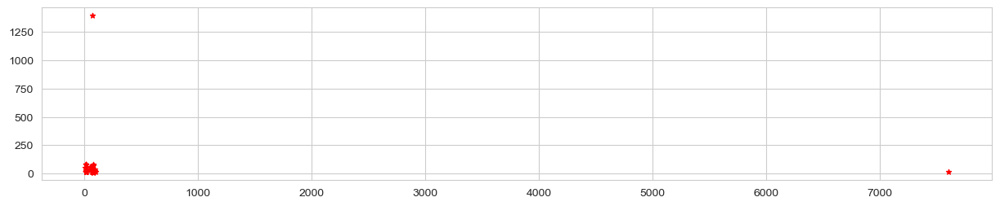

In [25]:
lo = list(X_hyp_rem['Longitude'])
la = list(X_hyp_rem['Latitude'])
res_lo = [float(i) for i in lo]
res_la = [float(j) for j in la]
fig,ax = plt.subplots(figsize = (15,15))
karnataka_df.plot(ax = ax)
geometry = [Point(xy) for xy in zip(res_lo,res_la)]
geo_df = gpd.GeoDataFrame(geometry = geometry)
g = geo_df.plot(ax = ax, markersize = 20, color = 'red',marker = '*',label = 'Karnataka')
plt.show()

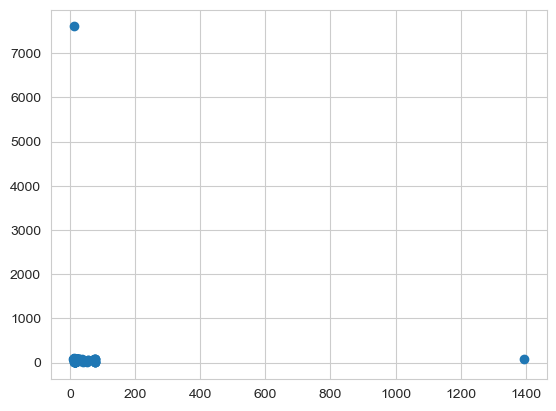

In [26]:
plt.scatter(res_la,res_lo)
plt.show()

In [27]:
X_hyp_rem.dtypes

StateName    object
Latitude     object
Longitude    object
dtype: object

In [28]:
X_hyp_rem['Longitude'].astype(float)

429       76.797100
430       78.595500
1202      74.878526
9790      76.270000
9791      76.270000
            ...    
156499    75.145737
156500    75.122869
156501    75.151495
156502    75.143347
156503    75.353393
Name: Longitude, Length: 8387, dtype: float64

In [29]:
X_hyp_rem['Latitude'] = X_hyp_rem['Latitude'].astype(float)
X_hyp_rem['Longitude'] = X_hyp_rem['Longitude'].astype(float)

C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\932015587.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_hyp_rem['Latitude'] = X_hyp_rem['Latitude'].astype(float)
C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\932015587.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_hyp_rem['Longitude'] = X_hyp_rem['Longitude'].astype(float)


In [30]:
filt7 = X_hyp_rem['Longitude'] >= 200
print(X_hyp_rem[filt7])
print('Latittude')
filt8 = X_hyp_rem['Latitude'] >= 200
print(X_hyp_rem[filt8])

       StateName  Latitude  Longitude
40267  KARNATAKA     12.61     7605.0
Latittude
       StateName  Latitude  Longitude
70248  KARNATAKA    1395.0      74.86


In [31]:
filt9 = (X_hyp_rem['Longitude'] >= 200) | (X_hyp_rem['Latitude'] >= 200)
X_hyp_rem[filt9]

,StateName,Latitude,Longitude
40267,KARNATAKA,12.61,7605.00
70248,KARNATAKA,1395.00,74.86


### we will remove the above 2 datapoints from the dataset as they will give skewed results due to the large distance form the other datasets
* This is a valid assumptio as the $K$-Means Algorithm operates by taking means of the datapoints to identify clusters.

In [32]:
X_hyp_rem_sk = X_hyp_rem[~filt9]

### Running the Scatter plot again with the map

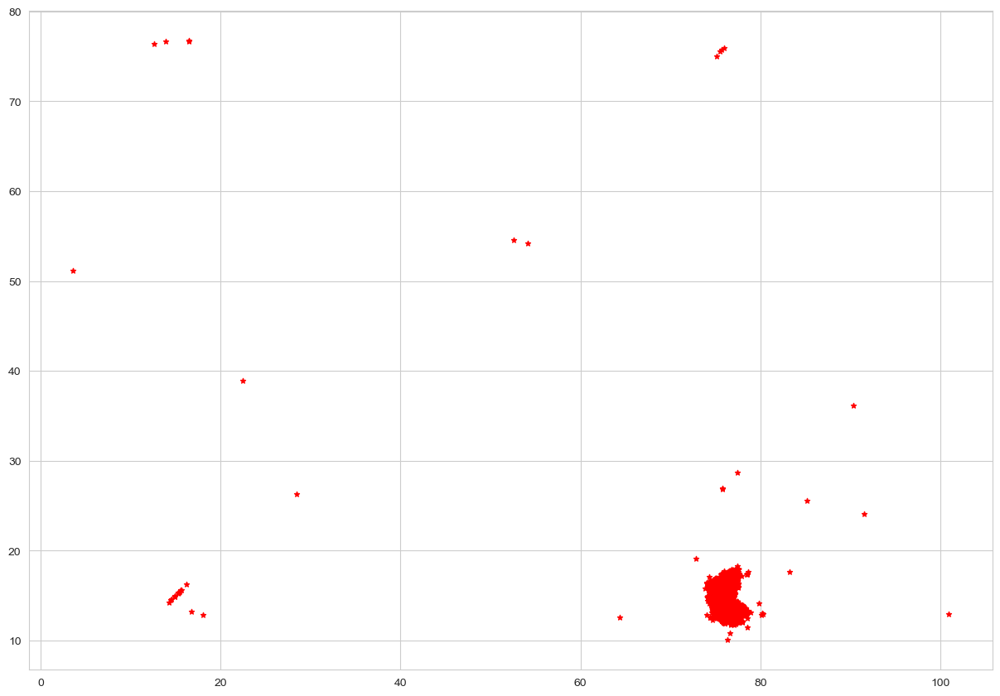

In [33]:
lo = list(X_hyp_rem_sk['Longitude'])
la = list(X_hyp_rem_sk['Latitude'])
fig,ax = plt.subplots(figsize = (15,15))
karnataka_df.plot(ax = ax)
geometry = [Point(xy) for xy in zip(lo,la)]
geo_df = gpd.GeoDataFrame(geometry = geometry)
g = geo_df.plot(ax = ax, markersize = 20, color = 'red',marker = '*',label = 'Karnataka')
plt.show()


### We will look at the image provided below of the official map of state of Karnataka to look at all the lattitude an longitude points to see the range for lattitude and longitude such that the points are actually within the state of karnataka.


<img src="images/karnataka-lat-long-map.jpg" width="500" height="500">


* From the Image we can infer that the ranges are as follows:
 * longitude ranges --> (74 to 79)
 * latitude ranges -->  (11 to 19)
  

**Note**: Image Source --> https://www.mapsofindia.com/lat_long/karnataka/


In [34]:
#Now we will filter the dataset again to include just points from the given ranges and plot a scatter plot for vizualization
filt10 = (X_hyp_rem_sk['Latitude']>11)&(X_hyp_rem_sk['Latitude']<19)
X_hyp_rem_sk[~filt10]
X_hyp_rem_sk[~filt10].shape

(22, 3)

In [35]:
filt11 = (X_hyp_rem_sk['Longitude']>74)&(X_hyp_rem_sk['Longitude']<79)
X_hyp_rem_sk[~filt11]
X_hyp_rem_sk[~filt11].shape

(36, 3)

In [36]:
filt12 = ((X_hyp_rem_sk['Latitude']>11)&(X_hyp_rem_sk['Latitude']<19)) & ((X_hyp_rem_sk['Longitude']>74)&(X_hyp_rem_sk['Longitude']<79))
X_hyp_rem_sk[~filt12].shape

(45, 3)

(8340, 3)


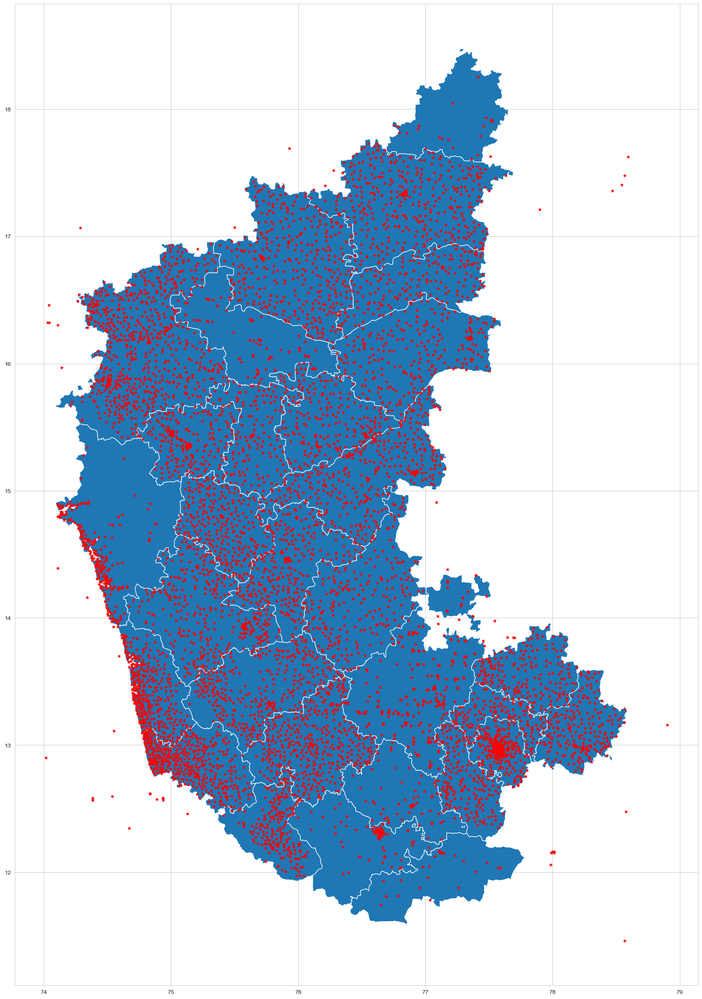

In [37]:

# From the above code we have found 45 outliers to our constraints therefore we will remove these datapoints form our dataset and plot the scatter map 
# again

X_n = X_hyp_rem_sk[filt12]
print(X_n.shape)
lo = list(X_n['Longitude'])
la = list(X_n['Latitude'])
fig,ax = plt.subplots(figsize = (30,30))
karnataka_df.plot(ax = ax)
geometry = [Point(xy) for xy in zip(lo,la)]
geo_df = gpd.GeoDataFrame(geometry = geometry)
g = geo_df.plot(ax = ax, markersize = 20, color = 'red',marker = '*',label = 'Karnataka')
plt.show()

In [38]:
fp = r'Karnataka'
k_df = gpd.read_file(fp)
k_df

,KGISStateI,KGISStateC,KGISStateN,created_us,created_da,last_edite,last_edi_1,SHAPE_STAr,SHAPE_STLe,geometry
0,1,29,Karnataka,None,0000/00/00,SURESHBV1,2022-12-02,1.918512e+11,4.777528e+06,"MULTIPOLYGON (((530654.289 1394659.955, 530651..."


<Axes: >

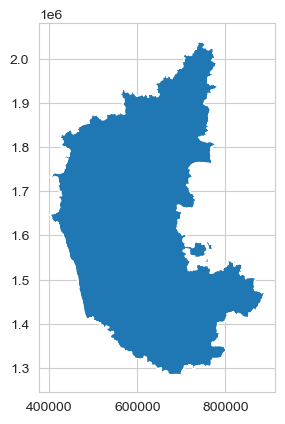

In [39]:
k_df.plot()

In [40]:
shape = k_df['geometry']

In [41]:
lo[0]

76.7971

In [42]:
la[0]

17.8155

In [43]:
shape.crs

<Projected CRS: EPSG:32643>
Name: WGS 84 / UTM zone 43N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: Between 72°E and 78°E, northern hemisphere between equator and 84°N, onshore and offshore. China. India. Kazakhstan. Kyrgyzstan. Maldives. Pakistan. Russian Federation. Tajikistan.
- bounds: (72.0, 0.0, 78.0, 84.0)
Coordinate Operation:
- name: UTM zone 43N
- method: Transverse Mercator
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [44]:
district_list = list(karnataka_df['geometry'])

In [45]:
district_list[0].geom_type

'Polygon'

In [46]:
k_df['geometry']

0    MULTIPOLYGON (((530654.289 1394659.955, 530651...
Name: geometry, dtype: geometry

<a name="3"></a>
## 3 - Implementing K-means

The K-means algorithm is a method to automatically cluster similar
data points together. 

* K-means is an iterative procedure that
     * Starts by guessing the initial centroids, and then 
     * Refines this guess by 
         * Repeatedly assigning examples to their closest centroids, and then 
         * Recomputing the centroids based on the assignments.

* The inner-loop of the algorithm repeatedly carries out two steps: 
    1. (Finding closest centroids)Assigning each training example $x^{(i)}$ to its closest centroid, and
    2. (Computing Centroid Means)Recomputing the mean of each centroid using the points assigned to it. 
    
    
* The $K$-means algorithm will always converge to some final set of means for the centroids.

We will implement the two phases of the K-means algorithm separately

<a name="3.1"></a>
### 3.1 Finding closest centroids

In the “cluster assignment” phase of the K-means algorithm, the
algorithm assigns every training example $x^{(i)}$ to its closest
centroid, given the current positions of centroids.

. 
* The function `find_closest_centroids` takes the data matrix `X` and the locations of all
centroids inside `centroids` 
* It outputs a one-dimensional array `idx` (which has the same number of elements as `X`) that holds the index  of the closest centroid (a value in $\{0,...,K-1\}$, where $K$ is total number of centroids) to every training example . 
* Specifically, for every example $x^{(i)}$ we set
$$c^{(i)} := j \quad \mathrm{that \; minimizes} \quad ||x^{(i)} - \mu_j||^2,$$
where 
 * $c^{(i)}$ is the index of the centroid that is closest to $x^{(i)}$ (corresponds to `idx[i]` in the starter code), and 
 * $\mu_j$ is the position (value) of the $j$’th centroid. (stored in `centroids` in the starter code)
 * $||x^{(i)} - \mu_j||$ is the L2-norm

In [47]:
def find_closest_centroids(X, centroids):
    """
    Computes the centroid memberships for every example
    
    Args:
        X (ndarray): (m, n) Input values      
        centroids (ndarray): (K, n) centroids
    
    Returns:
        idx (array_like): (m,) closest centroids
    
    """

    # Set K
    K = centroids.shape[0]

    # You need to return the following variables correctly
    idx = np.zeros(X.shape[0], dtype=int)

    ### START CODE HERE ###
    for i in range(X.shape[0]):
        distance = []
        for j in range(centroids.shape[0]):
            norm_ij = np.linalg.norm(X[i]-centroids[j]) #finding the L2 Norm
            distance.append(norm_ij)
        idx[i] = np.argmin(distance) #Updating closest centroids
     ### END CODE HERE ###
    
    return idx

<a name="3.2"></a>
### 3.2 Computing centroid means

Given assignments of every point to a centroid, the second phase of the
algorithm recomputes, for each centroid, the mean of the points that
were assigned to it.

* The function `compute_centroids` takes the data matrix `X` and the index of all closest
centroids for each data point in X `idx` and `K` which is the number of clusters to be found .

* Specifically, for every centroid $\mu_k$ we set
$$\mu_k = \frac{1}{|C_k|} \sum_{i \in C_k} x^{(i)}$$ 

    where 
    * $C_k$ is the set of examples that are assigned to centroid $k$
    * $|C_k|$ is the number of examples in the set $C_k$


* Concretely, if two examples say $x^{(3)}$ and $x^{(5)}$ are assigned to centroid $k=2$,
then you should update $\mu_2 = \frac{1}{2}(x^{(3)}+x^{(5)})$.

In [48]:
def compute_centroids(X, idx, K):
    """
    Returns the new centroids by computing the means of the 
    data points assigned to each centroid.
    
    Args:
        X (ndarray):   (m, n) Data points
        idx (ndarray): (m,) Array containing index of closest centroid for each 
                       example in X. Concretely, idx[i] contains the index of 
                       the centroid closest to example i
        K (int):       number of centroids
    
    Returns:
        centroids (ndarray): (K, n) New centroids computed
    """
    
    # Useful variables
    m, n = X.shape
    
    # You need to return the following variables correctly
    centroids = np.zeros((K, n))
    
    ### START CODE HERE ###
    for k in range(K):
        points = X[idx==k]
        centroids[k]= np.mean(points,axis=0)
    ### END CODE HERE ## 
    
    return centroids

<a name="3.3"></a>
### 3.3 - Random Initialization for running $K$-Means 
The initial assignments for the centroids can be chosen at random but generally a good practice is chose random data points on the data set as our initial centroids as it makes the algorithm converge a little bit more faster.

In this part we will implement the function `kMeans_init_centroids` the function operates as follows:
   * The code first randomly shuffles the indices of the examples (using `np.random.permutation()`). 
   * Then, it selects the first $K$ examples based on the random permutation of the indices.
     * This assumption is valid as we know that the number of clusters should be lower than the number of training examples i.e., $K<m$
             ($K$ --> is number of clusters & $m$ --> is the number of training examples)
   * This allows the examples to be selected at random without the risk of selecting the same example twice.

In [49]:
#Implementing the kMeans_init_centroids function

def kMeans_init_centroids(X, K):
    """
    This function initializes K centroids that are to be 
    used in K-Means on the dataset X
    
    Args:
        X (ndarray): Data points 
        K (int):     number of centroids/clusters
    
    Returns:
        centroids (ndarray): Initialized centroids
    """
    
    # Randomly reorder the indices of examples
    randidx = np.random.permutation(X.shape[0])
    
    # Take the first K examples as centroids
    centroids = X[randidx[:K]]
    
    return centroids

<a name="3.4"></a>
### 3.4 - Plot Vizualization after Iterations

This section contains the functions utilised in monitoring the progress of the K-means algorithm
* The functions are as listed below
  * `draw_line` takes p1,p2 as input where p1 and p2 are points
     * The function is used to draw lines between 2 points
  * `plot_data_with_centroids` takes `X` --> (Data in ndarray) `idx` --> (Array containing index of closest centroid for each example in X.)
    $k$ --> (Number of centroids/clusters)
     * The function plots data points in K different colors based on their closest centroids.
  * `plot_progress_kMeans_m` takes `X` --> (Data in ndarray) `idx` --> (Array containing index of closest centroid for each example in X.)
    $k$ --> (Number of centroids/clusters) `centroids` --> (Array containing updated centroids) `previous_centroids` --> (Array containing previous set     of centroids )
     * The function plots the scattered points in next iterration and also plots lines to mark the change in centroid locations
     * The function adds the state boundaries of the state (Karnataka)

<a name="3.4.1"></a>
#### 3.4.1 `draw_line` implementation

In [50]:
def draw_line(p1, p2, style="-k", linewidth=1):
    plt.plot([p1[0], p2[0]], [p1[1], p2[1]], style, linewidth=linewidth)

<a name="3.4.2"></a>
#### 3.4.2 `plot_data_with_centroids` implementation

In [111]:
def plot_data_with_centroids(X, idx, K):
  """
  Plots data points in K different colors based on their closest centroids.

  Args:
      X (ndarray): (m, n) Data points.
      idx (ndarray): (m,) Array containing index of closest centroid for each example in X.
      K (int): Number of centroids.
  """
  # Generate K random colors (one for each centroid)
  cmap = plt.cm.get_cmap('tab20')  # Use a colormap with at least K distinct colors
  colors = cmap(np.arange(K) % cmap.N)

  # Separate data points based on their closest centroids
  clustered_data = []
  for k in range(K):
    clustered_data.append(X[idx == k])

  # Plot each cluster with its corresponding color
  for i, data in enumerate(clustered_data):
    plt.scatter(data[:, 1], data[:, 0], label=f"Centroid {i+1}", c=colors[i])

  # Add labels and title
  plt.xlabel("Feature 1")
  plt.ylabel("Feature 2")
  plt.title("Data Points Colored by Closest Centroids (K={})".format(K))

  # Add legend to show color association with centroids (optional)
  #plt.legend()

  # Display the plot
  # plt.show()


<a name="3.4.3"></a>
#### 3.4.3 `plot_progress_kMeans_m` implementation

In [117]:
def plot_progress_kMeans_m(dataframe,X, centroids, previous_centroids, idx, K, i, plot_storage=False):
  """  
  Plots the K-Means progress in a single figure.

  Args:
      X (ndarray): (m, n) Data points.
      centroids (ndarray): (K, n) Centroids.
      previous_centroids (ndarray): (K, n) Previous centroids.
      idx (ndarray): (m,) Array containing index of closest centroid for each example in X.
      K (int): Number of centroids.
      i (int): Current iteration number.
      plot_storage (bool, optional): Whether to return the plot (for storage). Defaults to False.

  Returns:
      plt.Figure: The figure object containing the plot (if plot_storage is True).
  """ 

  # Plot the examples
  plot_data_with_centroids(X, idx, K)

  # Plot the centroids as black 'x's
  plt.scatter(centroids[:, 1], centroids[:, 0], marker='x', c='k', linewidths=3)

  # Plot history of the centroids with lines
  for j in range(centroids.shape[0]):
    x =  centroids[j, :]
    y =  previous_centroids[j, :] 
    draw_line(x[::-1], y[::-1])

  # Add labels and title
  plt.xlabel("Feature 1")
  plt.ylabel("Feature 2")
  plt.title("Iteration number %d" % i)

    # Iterate through each geometry in the 'geometry' column
  for geometry in dataframe['geometry']:
      if isinstance(geometry, Polygon):
          x, y = geometry.exterior.xy
      else:
          # If it's a MultiPolygon, iterate through each polygon and extract coordinates
          x_list, y_list = [], []
          for polygon in geometry.geoms:
              x, y = polygon.exterior.xy
              x_list.append(x)
              y_list.append(y)
          # Concatenate all polygon coordinates into single lists
          x = np.concatenate(x_list)
          y = np.concatenate(y_list)

      # Plot the current geometry on the axis with transparency
      plt.plot(x,y, color='red', linewidth=2, alpha=0.5)  
      plt.gca().invert_yaxis()
  # Return the plot object if plot_storage is True
  if plot_storage:
    return plt.gcf()  # Get the current figure object
  else:
    return None

<a name="3.5"></a>
### 3.5 - K-means on given dataset 

After we have completed the two functions (`find_closest_centroids`
and `compute_centroids`) above, the next step is to run the
K-means algorithm 
* The function (`run_kMeans`) takes the data Matrix `X`, `initial_centroids` is the initial location of centroids (Randomly assigned)
  `max_iters` is the Maximum number of times/iterations to run the K-means Algorithm , an additional boolean parameter `plot_progress` which is a step to look at the vizualization for the iterations.
* The plot can be understood as follows
   * The final centroids are the black X-marks in the middle of the colored clusters.
   * We can see how these centroids got to their final location by looking at the other X-marks connected to it.
     

In [96]:
# run_kMeans function to run the K-Means Algorithm

def run_kMeans(X, initial_centroids, max_iters=10, plot_progress=False, plot_storage=False):
  """
  Runs the K-Means algorithm on data matrix X, where each row of X
  is a single example.

  Args:
      X (ndarray): (m, n) Data points.
      initial_centroids (ndarray): (K, n) Initial centroids.
      max_iters (int, optional): Maximum number of iterations. Defaults to 10.
      plot_progress (bool, optional): Whether to plot progress during iterations. Defaults to False.
      plot_storage (bool, optional): Whether to store the last plot. Defaults to False.

  Returns:
      tuple: (centroids, idx, last_plot) if plot_storage is True, otherwise (centroids, idx)
  """

  m, n = X.shape
  K = initial_centroids.shape[0]
  centroids = initial_centroids
  previous_centroids = centroids
  idx = np.zeros(m)
  plt.figure(figsize=(35, 35))
  # Run K-Means
  for i in range(max_iters):

    # Output progress
    print("K-Means iteration %d/%d" % (i, max_iters - 1))

    # For each example in X, assign it to the closest centroid
    idx = find_closest_centroids(X, centroids)

    # Optionally plot progress or store the last plot
    if plot_progress:
      plot_progress_kMeans_m(karnataka_df,X, centroids, previous_centroids, idx, K, i,plot_storage)
    elif plot_storage:
      last_plot = plot_progress_kMeans_m(karnataka_df,X, centroids, previous_centroids, idx, K, i,plot_storage)

    previous_centroids = centroids

    # Given the memberships, compute new centroids
    centroids = compute_centroids(X, idx, K)

  # Show the last plot if plot_progress is True
  if plot_progress:
    #plt.gca().invert_yaxis()
    plt.show()
  # Return centroids, idx, and last_plot if storage is enabled
  if plot_storage:
    return centroids, idx, last_plot
  else:
    return centroids, idx

In [56]:
X_n

,StateName,Latitude,Longitude
429,KARNATAKA,17.815500,76.797100
430,KARNATAKA,17.625800,78.595500
1202,KARNATAKA,12.853372,74.878526
9790,KARNATAKA,13.320000,76.270000
9791,KARNATAKA,13.330000,76.270000
...,...,...,...
156499,KARNATAKA,15.369069,75.145737
156500,KARNATAKA,15.368268,75.122869
156501,KARNATAKA,15.361910,75.151495
156502,KARNATAKA,15.340767,75.143347


In [57]:
X_nd_df = X_n.drop(['StateName'],axis = 'columns') 

In [58]:
X_nd_df.reset_index(level = 0, inplace = True)

In [59]:
X_nd = X_nd_df.to_numpy()
print(X_nd)

[[4.29000000e+02 1.78155000e+01 7.67971000e+01]
 [4.30000000e+02 1.76258000e+01 7.85955000e+01]
 [1.20200000e+03 1.28533720e+01 7.48785260e+01]
 ...
 [1.56501000e+05 1.53619099e+01 7.51514951e+01]
 [1.56502000e+05 1.53407672e+01 7.51433470e+01]
 [1.56503000e+05 1.55572968e+01 7.53533931e+01]]


In [60]:
X_nd.shape

(8340, 3)

In [61]:
X_nd_2 = np.delete(X_nd,0,1)
print(X_nd_2)

[[17.8155    76.7971   ]
 [17.6258    78.5955   ]
 [12.853372  74.878526 ]
 ...
 [15.3619099 75.1514951]
 [15.3407672 75.143347 ]
 [15.5572968 75.3533931]]


In [62]:
X_nd_2.shape

(8340, 2)

In [97]:
X_nd_3 = X_nd_2[:,[1,0]]

In [98]:
X_nd_3

array([[76.7971   , 17.8155   ],
       [78.5955   , 17.6258   ],
       [74.878526 , 12.853372 ],
       ...,
       [75.1514951, 15.3619099],
       [75.143347 , 15.3407672],
       [75.3533931, 15.5572968]])

<a name="3.6"></a>
### 3.6 - Running $K$-Means Clustering on the filtered dataset

We will run the $K$-Means function initially with 30 clusters we are using 30 clusters here because the number of districts in Karnataka are 30
we can check how our algorithm is clustering the points in districts and compare it to the state map of Karnataka to check its performance

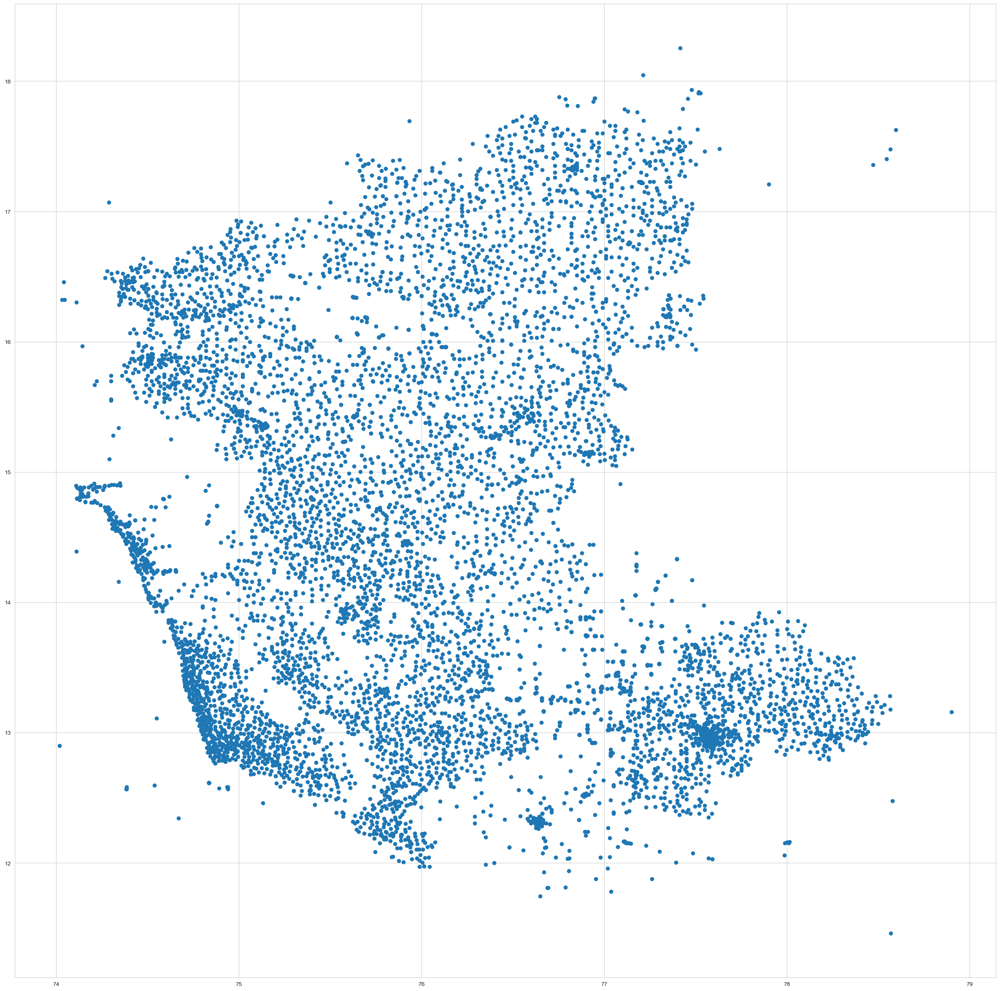

In [63]:
#longitude - (X-axis) and latitude - (Y-axis)
plt_1 = plt.figure(figsize=(30, 30))
plt.scatter(lo,la)
plt.show()

#### Initial Run with 10 iterations and 30 clusters (Run-1)

K-Means iteration 0/9


C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20')  # Use a colormap with at least K distinct colors
C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:21: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(data[:, 1], data[:, 0], label=f"Centroid {i+1}", c=colors[i])


K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9


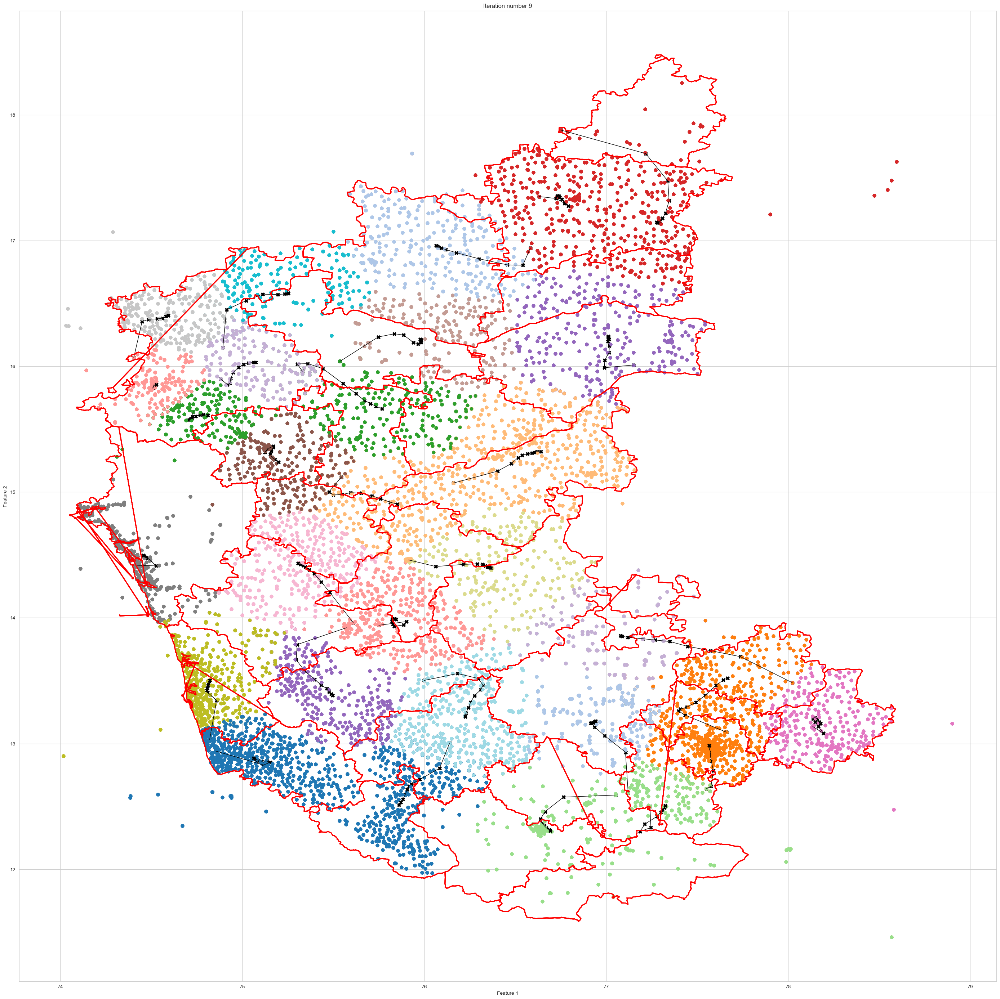

In [118]:
# Set initial centroids

K = 30

initial_centroids = kMeans_init_centroids(X_nd_2, K) 

# Number of iterations
max_iters = 10

# Run K-Means
centroids, idx = run_kMeans(X_nd_2, initial_centroids, max_iters, plot_progress=True)

#### Second Run with 20 iterations and 30 clusters (Run-2) Keeping initial clusters same

K-Means iteration 0/19


C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20')  # Use a colormap with at least K distinct colors
C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:21: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(data[:, 1], data[:, 0], label=f"Centroid {i+1}", c=colors[i])


K-Means iteration 1/19
K-Means iteration 2/19
K-Means iteration 3/19
K-Means iteration 4/19
K-Means iteration 5/19
K-Means iteration 6/19
K-Means iteration 7/19
K-Means iteration 8/19
K-Means iteration 9/19
K-Means iteration 10/19
K-Means iteration 11/19
K-Means iteration 12/19
K-Means iteration 13/19
K-Means iteration 14/19
K-Means iteration 15/19
K-Means iteration 16/19
K-Means iteration 17/19
K-Means iteration 18/19
K-Means iteration 19/19


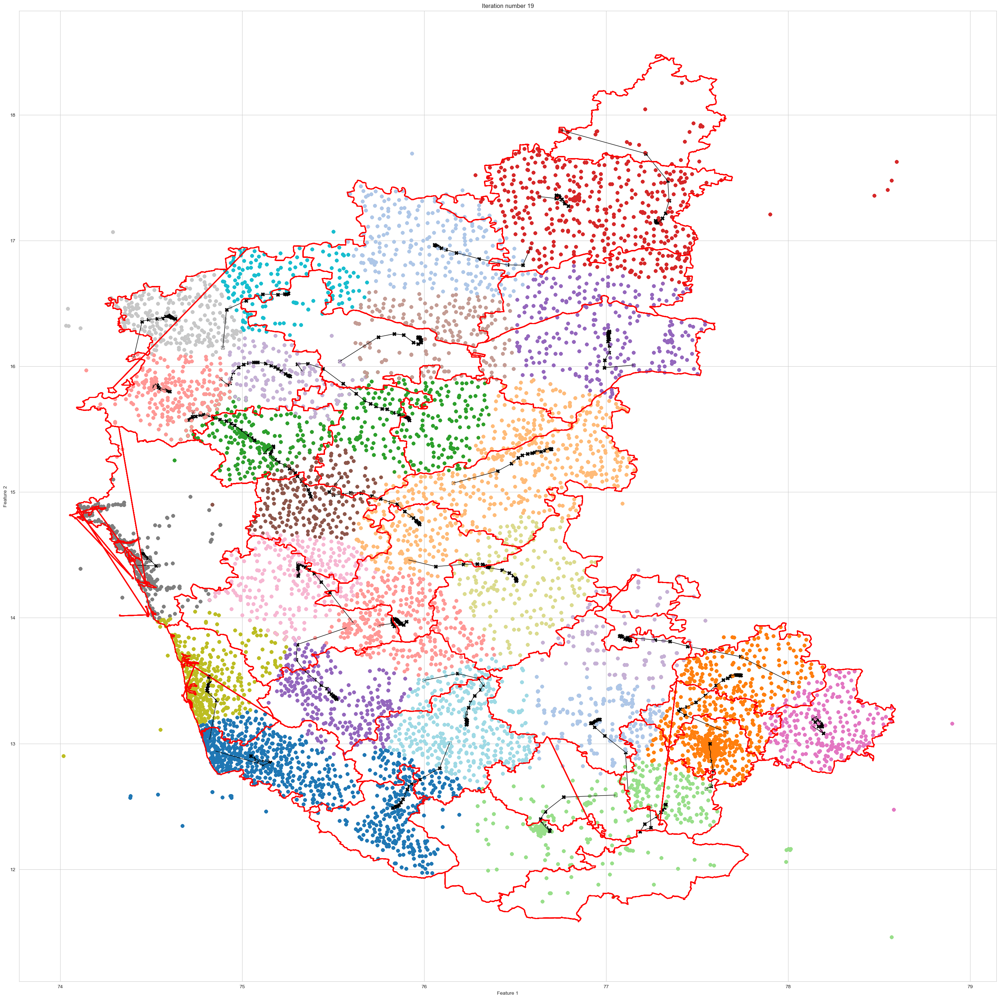

In [119]:
max_iters = 20

# Run K-Means
centroids, idx = run_kMeans(X_nd_2, initial_centroids, max_iters, plot_progress=True)

### Third Run with 10 iterations and 30 clusters after changing the initial centroids

From the results of the first and the second run we can understand that the algorithm has converged after 10 iterations as the cluster location hasn't changed much after more iterations.

We will now change the initial centroids to see how it affects the clustering.

K-Means iteration 0/9


C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20')  # Use a colormap with at least K distinct colors
C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:21: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(data[:, 1], data[:, 0], label=f"Centroid {i+1}", c=colors[i])


K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9


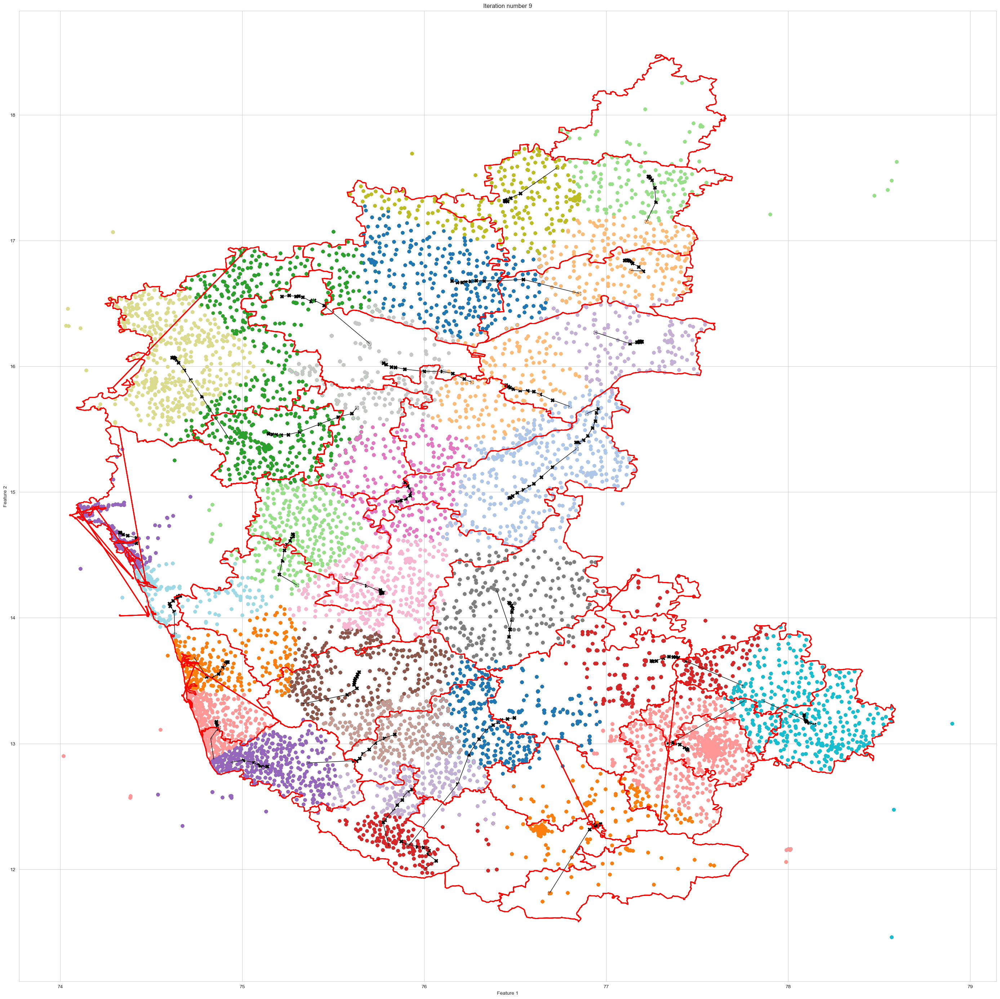

In [120]:
# Set initial centroids

K = 30

initial_centroids = kMeans_init_centroids(X_nd_2, K) 

# Number of iterations
max_iters = 10

# Run K-Means
centroids, idx = run_kMeans(X_nd_2, initial_centroids, max_iters, plot_progress=True)

### Fourth run with 20 iterations and 30 clusters without changing the initial clusters
We will study the converging again

K-Means iteration 0/19


C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20')  # Use a colormap with at least K distinct colors
C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:21: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(data[:, 1], data[:, 0], label=f"Centroid {i+1}", c=colors[i])


K-Means iteration 1/19
K-Means iteration 2/19
K-Means iteration 3/19
K-Means iteration 4/19
K-Means iteration 5/19
K-Means iteration 6/19
K-Means iteration 7/19
K-Means iteration 8/19
K-Means iteration 9/19
K-Means iteration 10/19
K-Means iteration 11/19
K-Means iteration 12/19
K-Means iteration 13/19
K-Means iteration 14/19
K-Means iteration 15/19
K-Means iteration 16/19
K-Means iteration 17/19
K-Means iteration 18/19
K-Means iteration 19/19


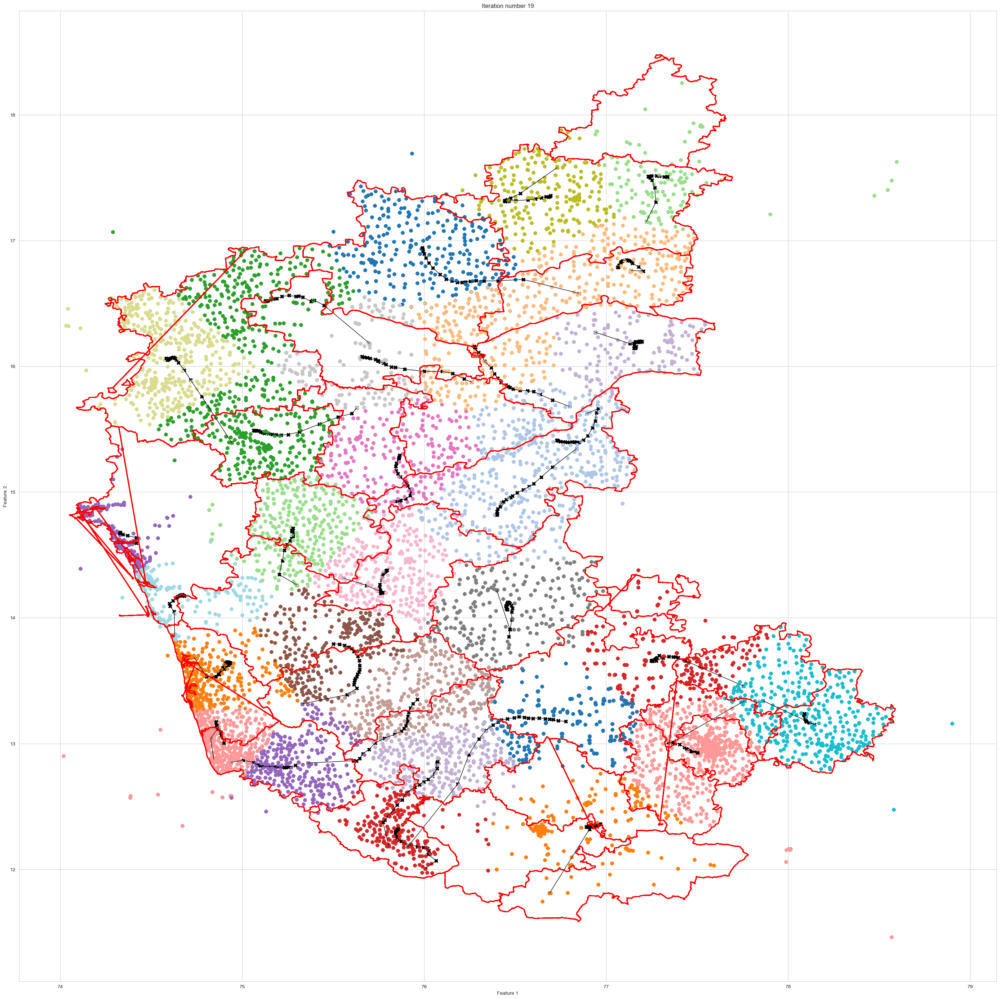

In [121]:
max_iters = 20

# Run K-Means
centroids, idx = run_kMeans(X_nd_2, initial_centroids, max_iters, plot_progress=True)

Trying to increase the figsize for better visualization

K-Means iteration 0/19


C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20')  # Use a colormap with at least K distinct colors
C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:21: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(data[:, 1], data[:, 0], label=f"Centroid {i+1}", c=colors[i])


K-Means iteration 1/19
K-Means iteration 2/19
K-Means iteration 3/19
K-Means iteration 4/19
K-Means iteration 5/19
K-Means iteration 6/19
K-Means iteration 7/19
K-Means iteration 8/19
K-Means iteration 9/19
K-Means iteration 10/19
K-Means iteration 11/19
K-Means iteration 12/19
K-Means iteration 13/19
K-Means iteration 14/19
K-Means iteration 15/19
K-Means iteration 16/19
K-Means iteration 17/19
K-Means iteration 18/19
K-Means iteration 19/19


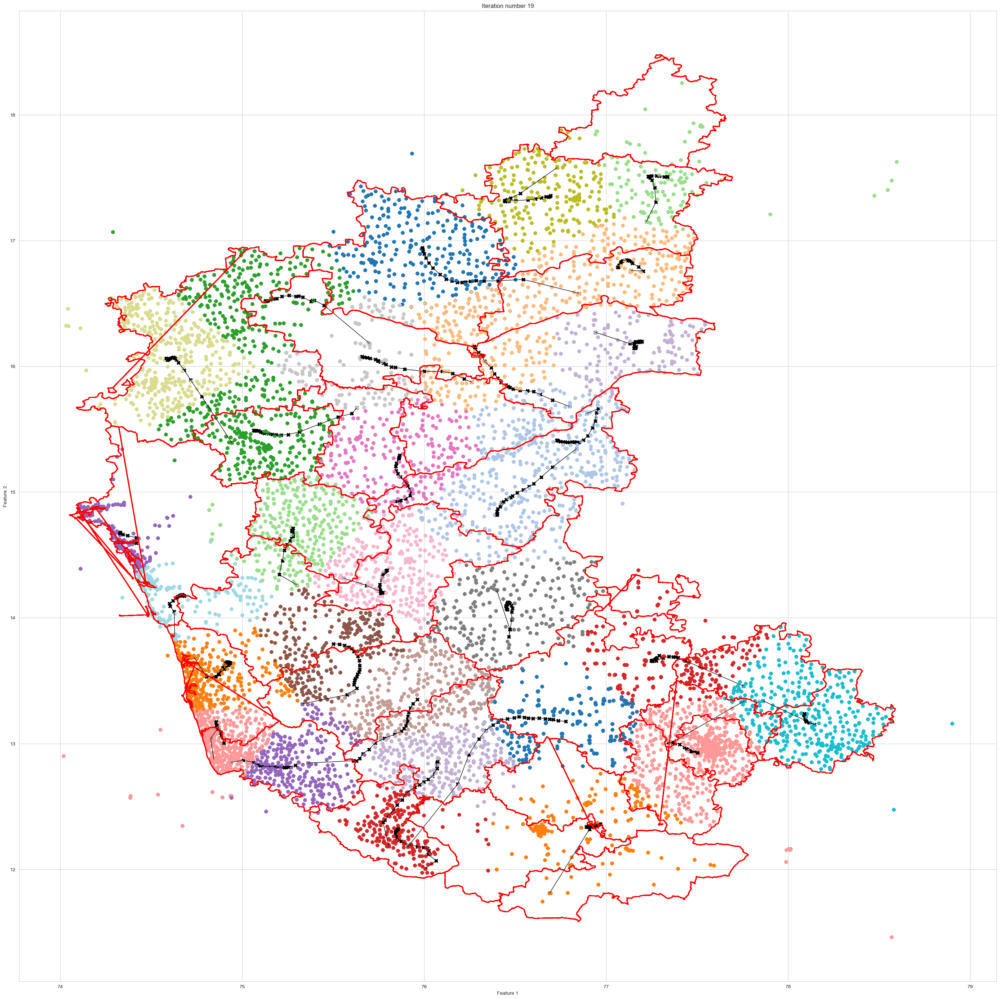

In [122]:
max_iters = 20

# Run K-Means
centroids, idx = run_kMeans(X_nd_2, initial_centroids, max_iters, plot_progress=True)

<a name="3.7"></a>
### 3.7 Evaluating the cluster results 

Since lot of different clusters are obtained after we need a method to evaluate the clusters formed we need to evaluate each cluster by some methods
The aim of K-Means Clustering is to find the best cluster by minimising the cost function 

* The Cost function is as follows
  $$J = \sum_{j = 1}^{k}\sum_{i = 1}^{n} ||x_{i}^{(j)}-c_j||^2$$ 

    where 
    * $k$ is the number of clusters
    * $n$ is the number of cases
    * $x_{i}^{(j)}$ is the datapoint i of j th cluster
    * $c_j$ is the centroid of cluster j
    * $||x_{i}^{(j)}-c_j||^2$ is the distance between $x_{i}^{(j)}$ and $c_j$
      


We will run the algorithm with different initial points and return the one with the lowest cost value and also return the set of initial coordinates that resulted in a cluster with lowest cost.

In [123]:
def calculate_cost(X, centroids, idx):
  """
  Calculates the K-means cost function for a given data set, centroids, and labels.

  Args:
      X (ndarray): (m, n) Data points.
      centroids (ndarray): (K, n) Centroids.
      idx (ndarray): (m,) Array containing the cluster label for each data point.

  Returns:
      float: The total K-means cost.
  """
  cost = 0.0
  for i, point in enumerate(X):
    centroid_idx = idx[i]
    centroid = centroids[centroid_idx]
    distance = np.linalg.norm(point - centroid) ** 2  # Squared Euclidean distance
    cost += distance
  return cost

In [124]:
cost = calculate_cost(X_nd_2,centroids, idx)
print(cost)

696.4967084545117


In [188]:
def Run_K_Means_iterate(num_iterations,K):
  results = []
  for b in range(num_iterations):
    initial_centroids = kMeans_init_centroids(X_nd_2, K)
    max_iters = 10
    centroids, idx , plot = run_kMeans(X_nd_2, initial_centroids, max_iters, plot_progress=False,plot_storage = True)
    cost = calculate_cost(X_nd_2, centroids, idx)
    results.append({'centroids': centroids, 'idx': idx, 'initial_centroids': initial_centroids, 'cost': cost , 'plots':plot})
  return results    

K-Means iteration 0/9


C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20')  # Use a colormap with at least K distinct colors
C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:21: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(data[:, 1], data[:, 0], label=f"Centroid {i+1}", c=colors[i])


K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9


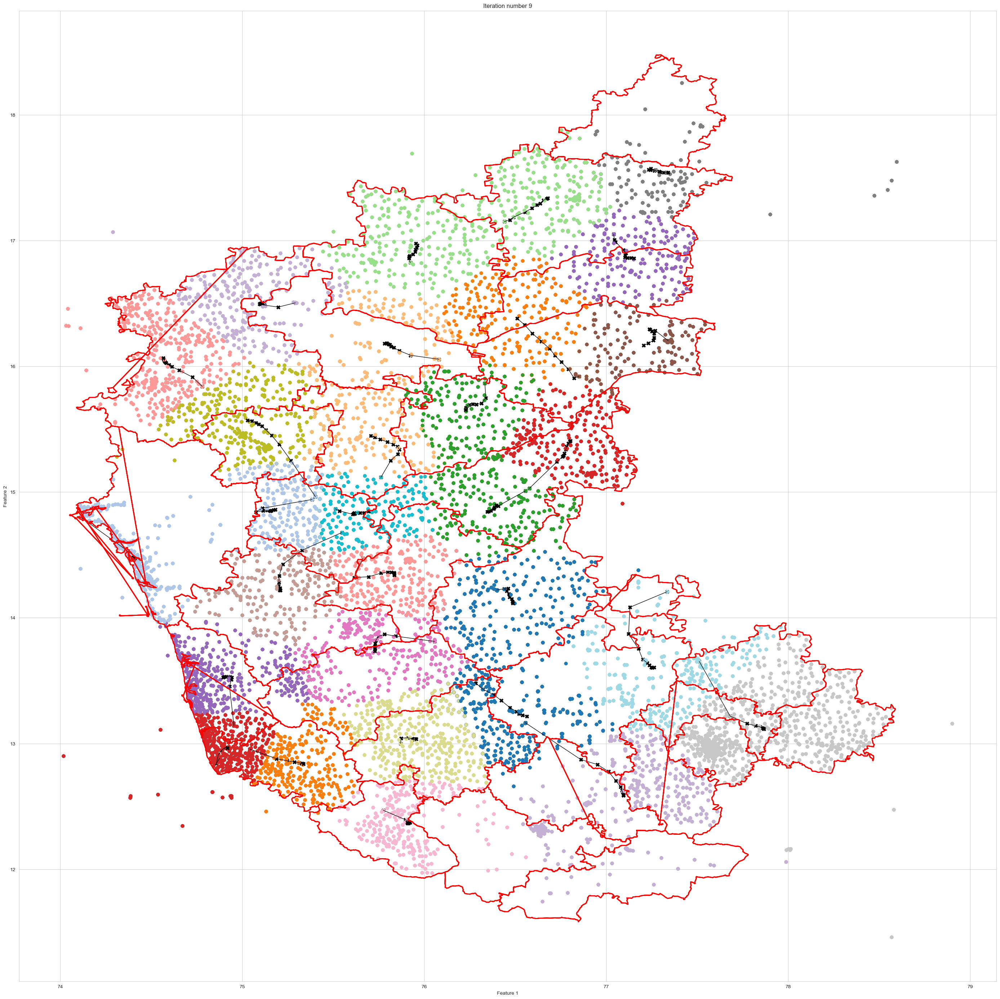

In [126]:
results = Run_K_Means_iterate(1)

#### Using Elbow method to evaluate for number of clusters

In [127]:
def elbow_method(X, k_range):
  """
  Implements the elbow method to find the optimal number of clusters (K) for K-Means clustering.

  Args:
      X (ndarray): (m, n) Data points.
      k_range (list): List of values for K (number of clusters) to try.

  Returns:
      tuple: (WCSS_list, optimal_k)
          - WCSS_list (list): List of Within-Cluster Sum of Squares (WCSS) for each K value.
          - optimal_k (int): The optimal number of clusters based on the elbow point.
  """

  WCSS_list = []
  for K in k_range:
    # Run K-Means with current K value
    centroids, idx = run_kMeans(X, kMeans_init_centroids(X, K), max_iters=10)  # Assuming you have kMeans_init_centroids implemented

    # Calculate WCSS using your calculate_cost function
    WCSS = calculate_cost(X, centroids, idx)

    # Append WCSS to the list
    WCSS_list.append(WCSS)

  # Plot the elbow graph
  plt.figure(figsize=(35, 35))  
  plt.plot(k_range, WCSS_list)
  plt.xlabel("Number of Clusters (K)")
  plt.ylabel("Within-Cluster Sum of Squares (WCSS)")
  plt.title("Elbow Method for K-Means Clustering")
  plt.grid(True)
  plt.show()

  # Find the elbow point based on the minimum second derivative
  min_delta_WCSS = float('inf')
  optimal_k = k_range[0]
  for i in range(1, len(k_range) - 1):
    delta_WCSS = WCSS_list[i + 1] - WCSS_list[i]
    if abs(delta_WCSS) < min_delta_WCSS:
      min_delta_WCSS = abs(delta_WCSS)


In [132]:
l = list(np.arange(21))
l.remove(0)

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

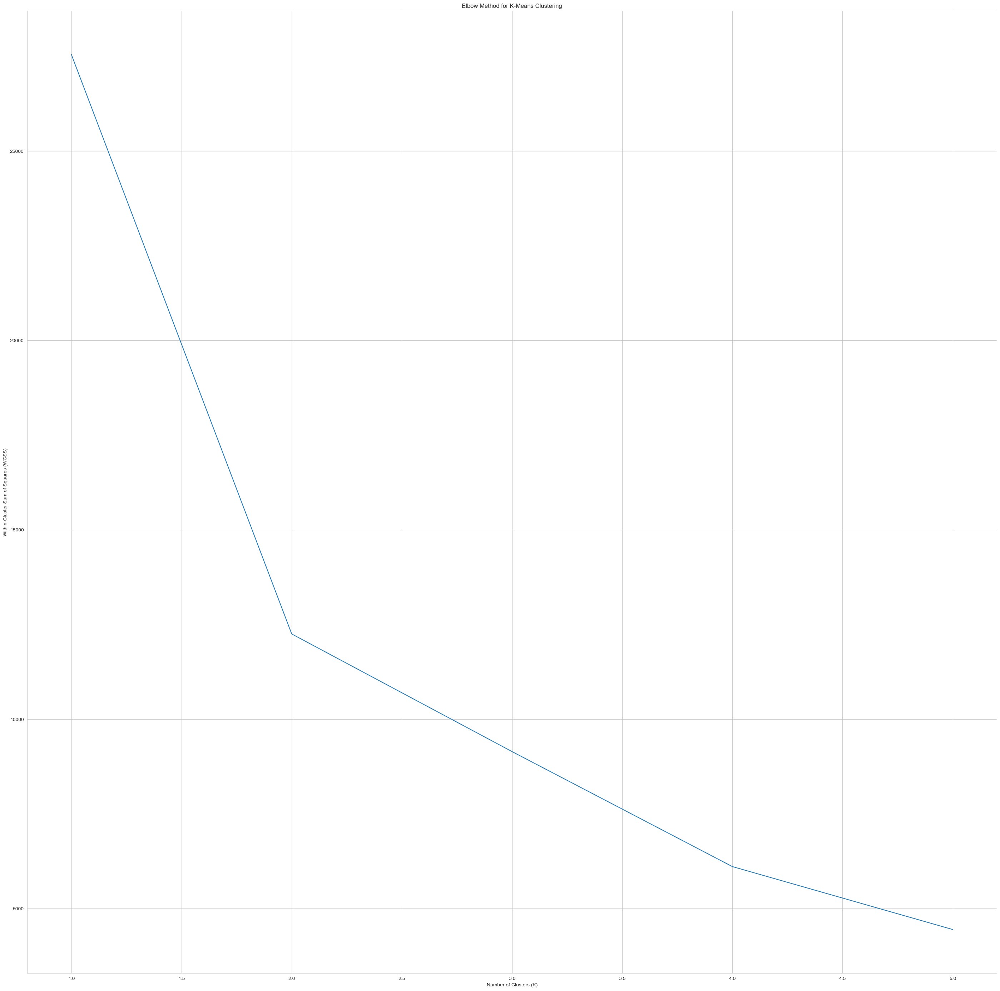

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

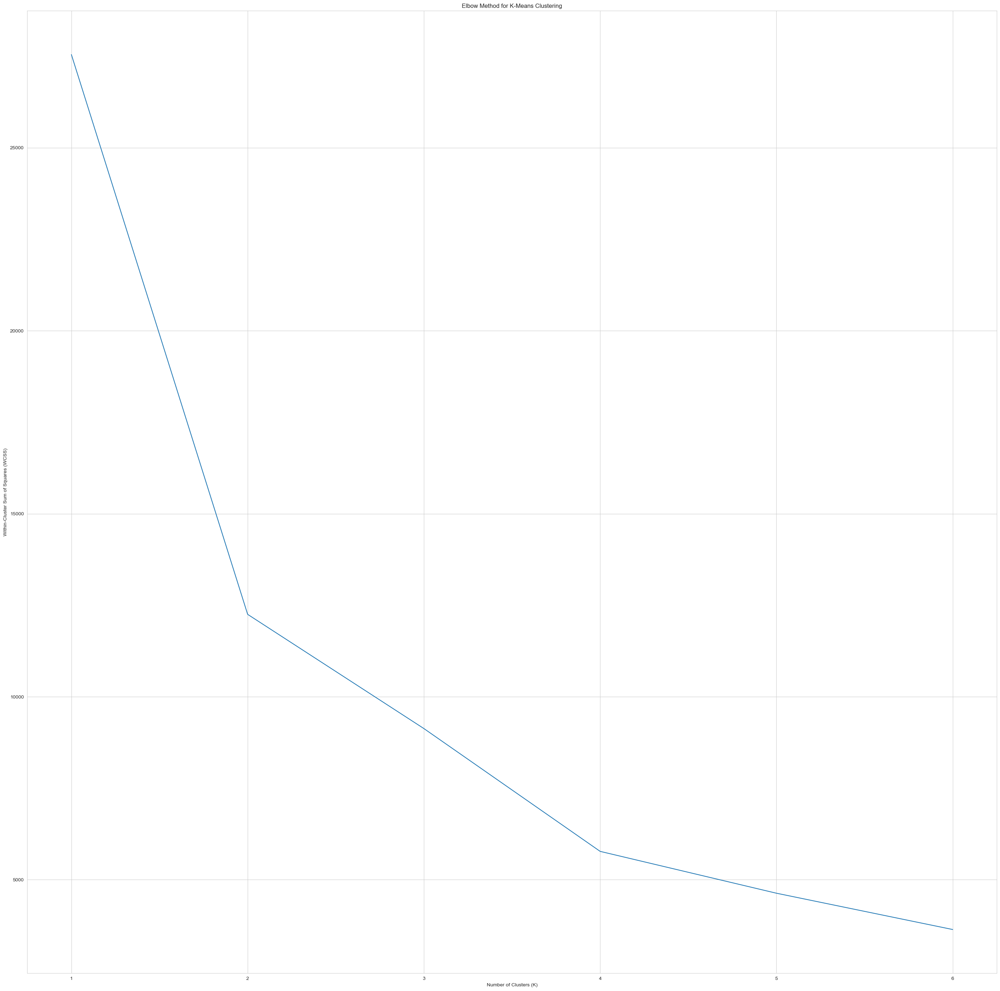

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

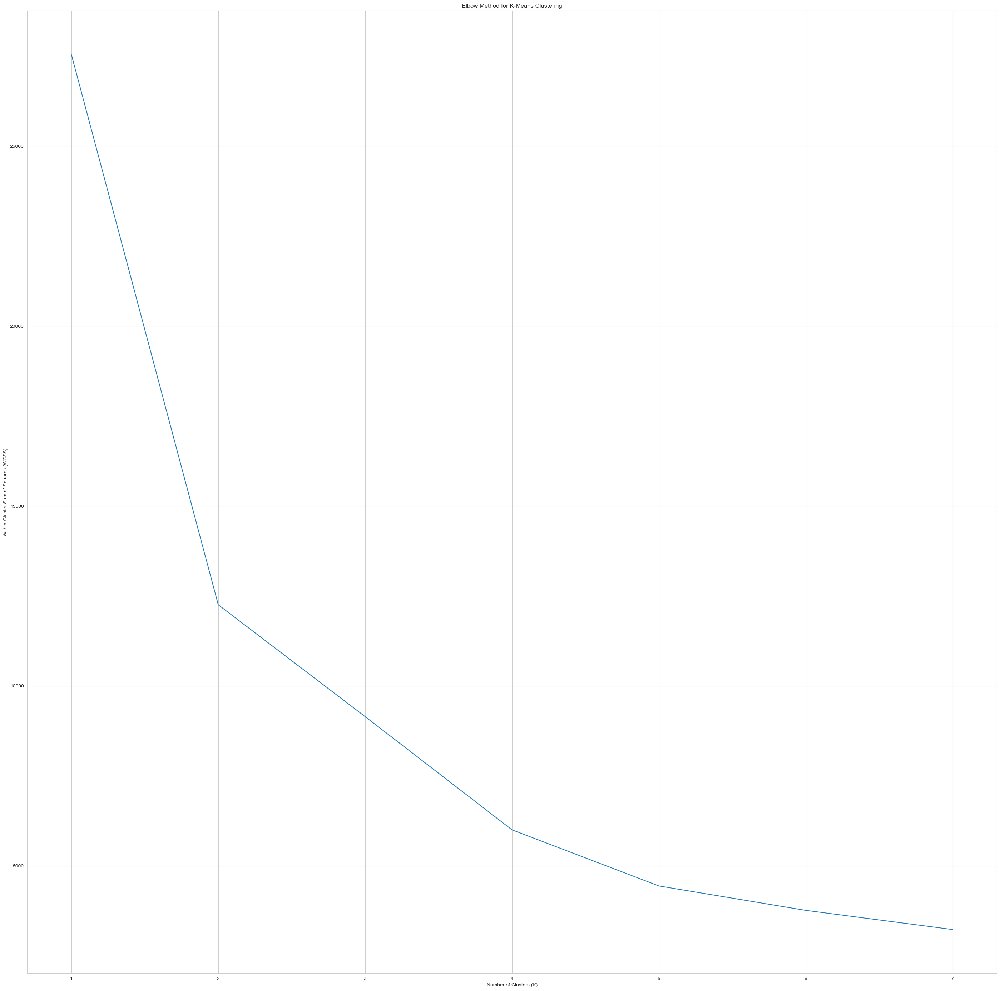

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

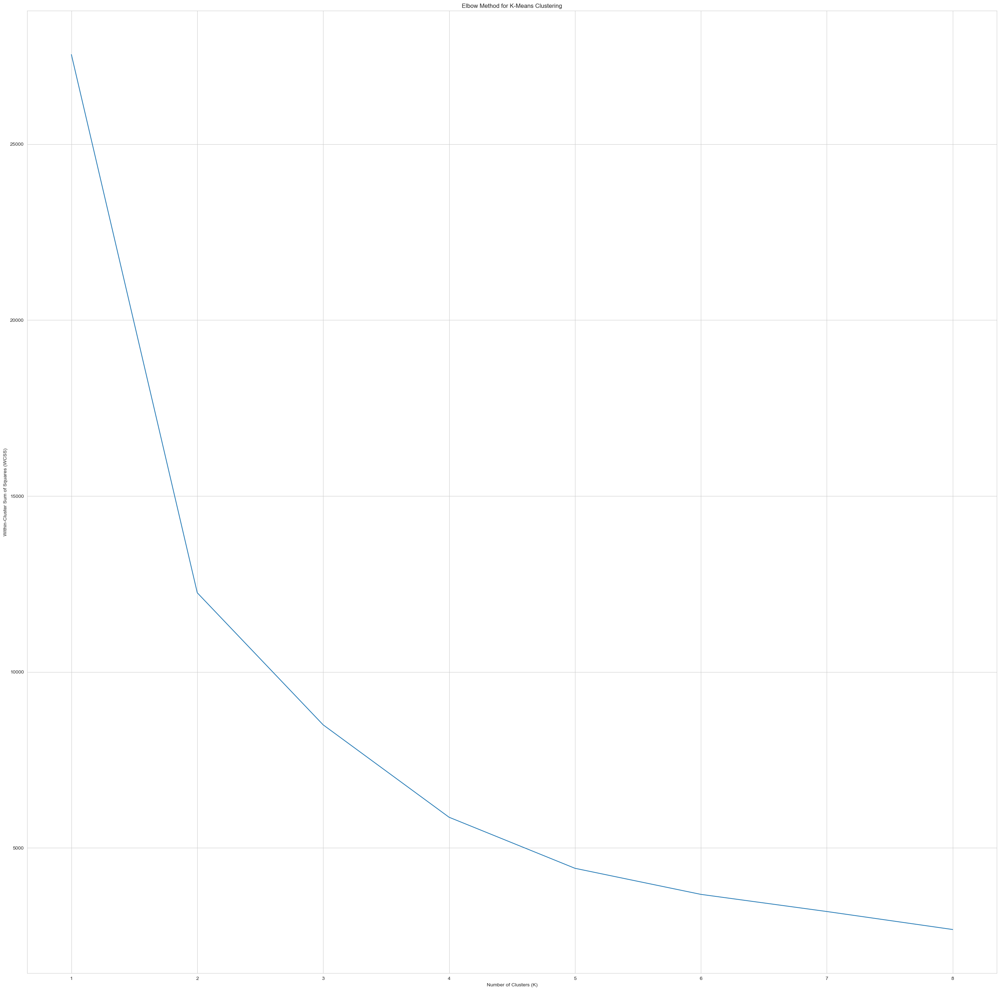

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

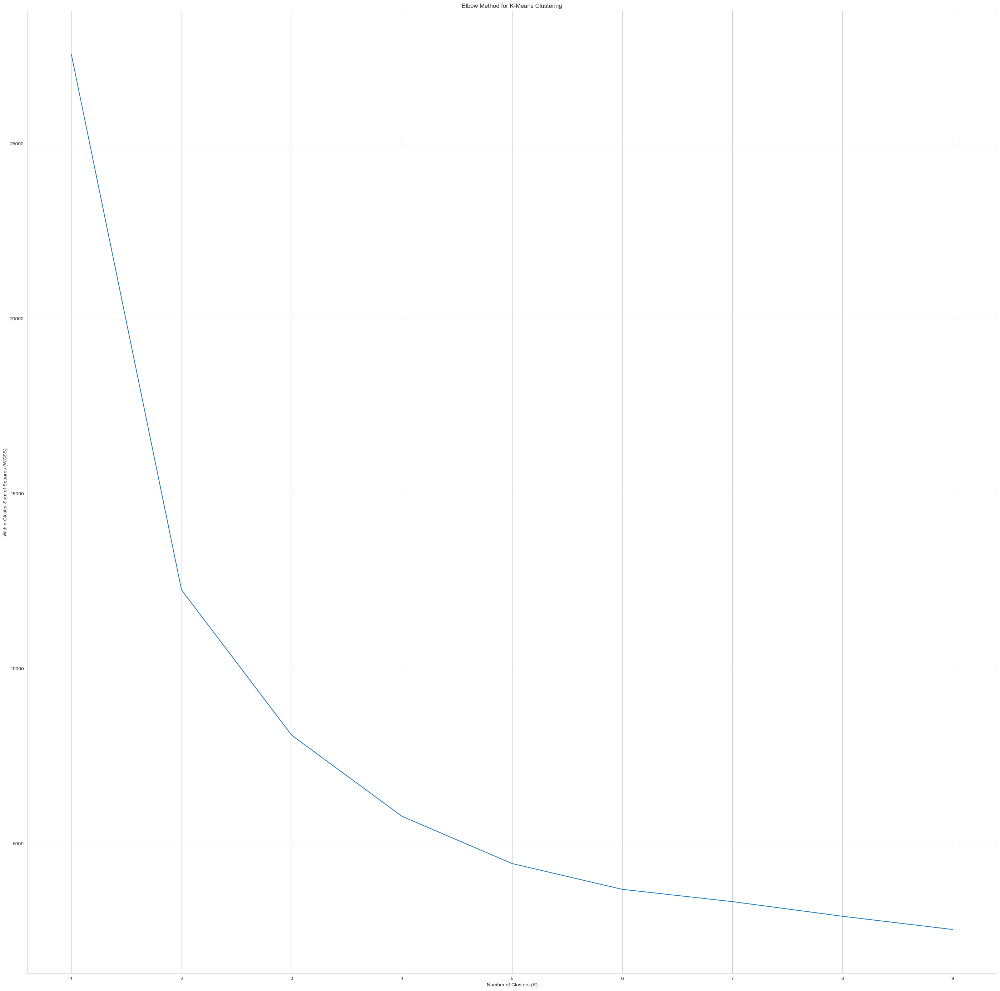

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

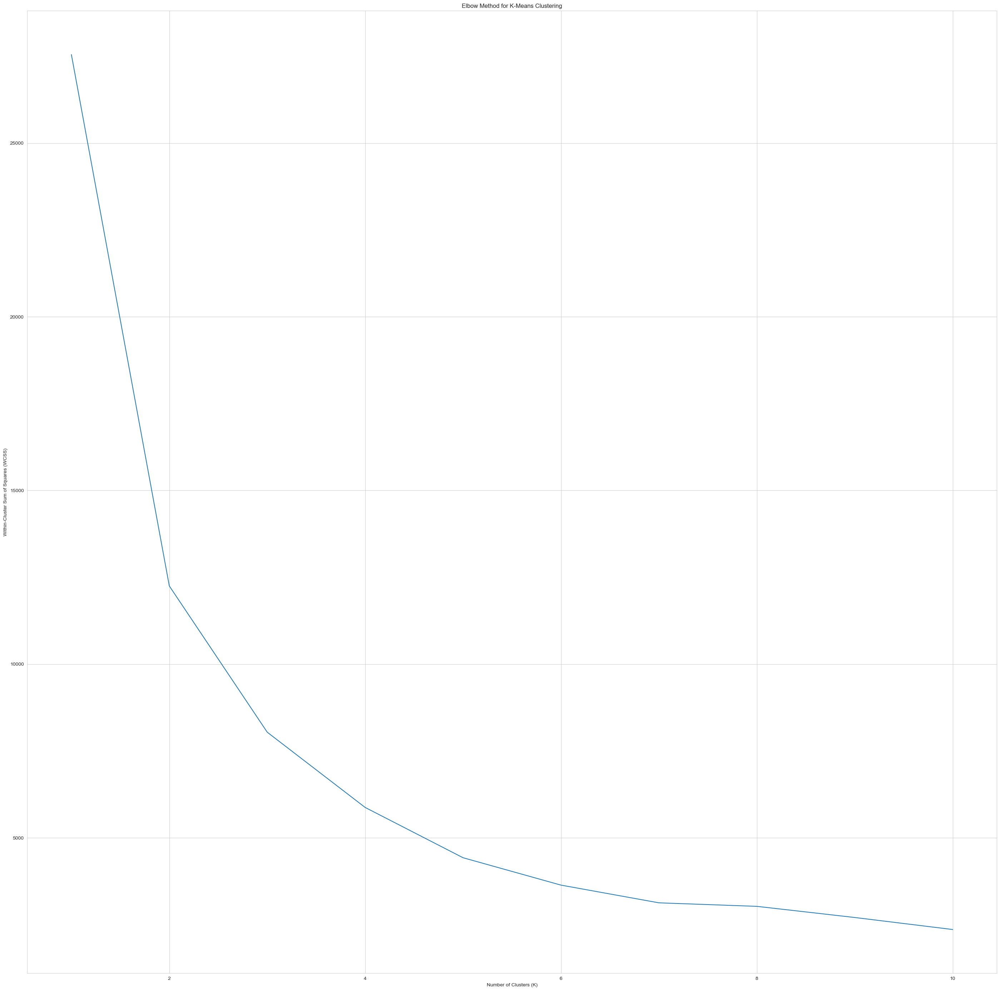

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

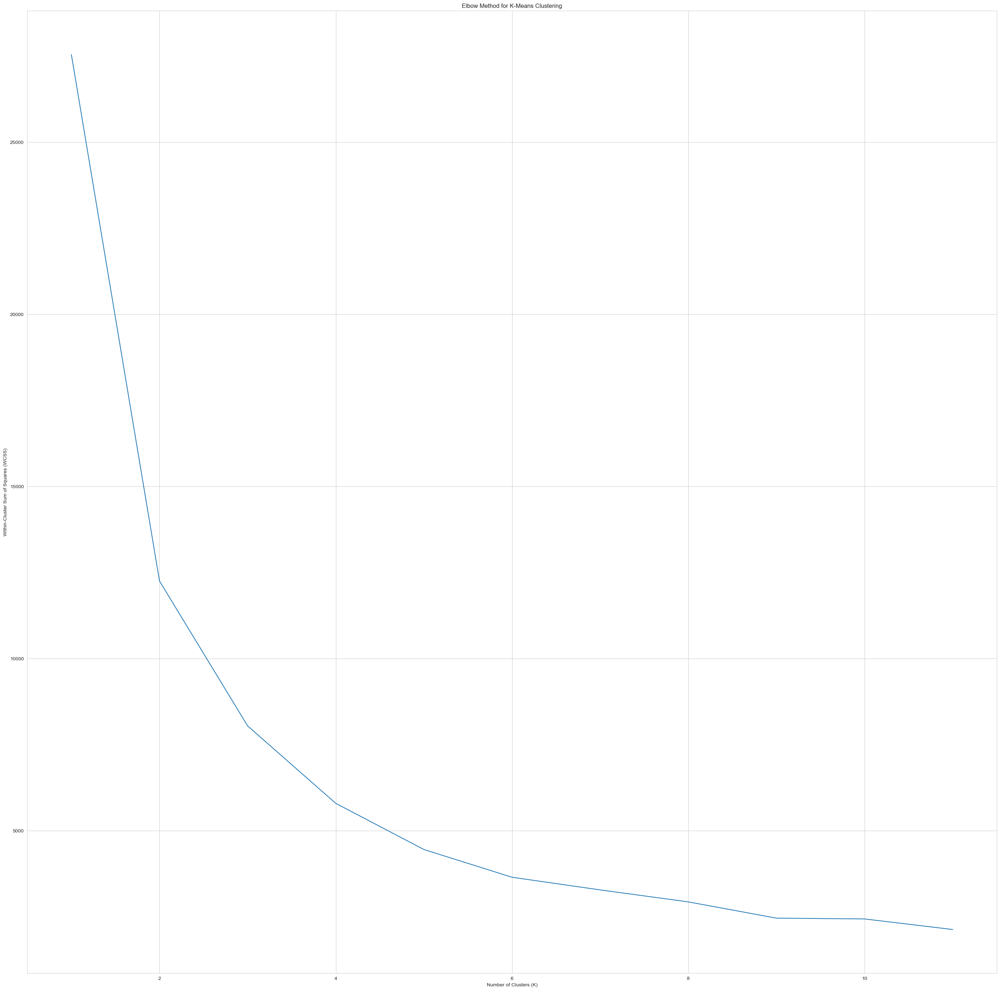

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

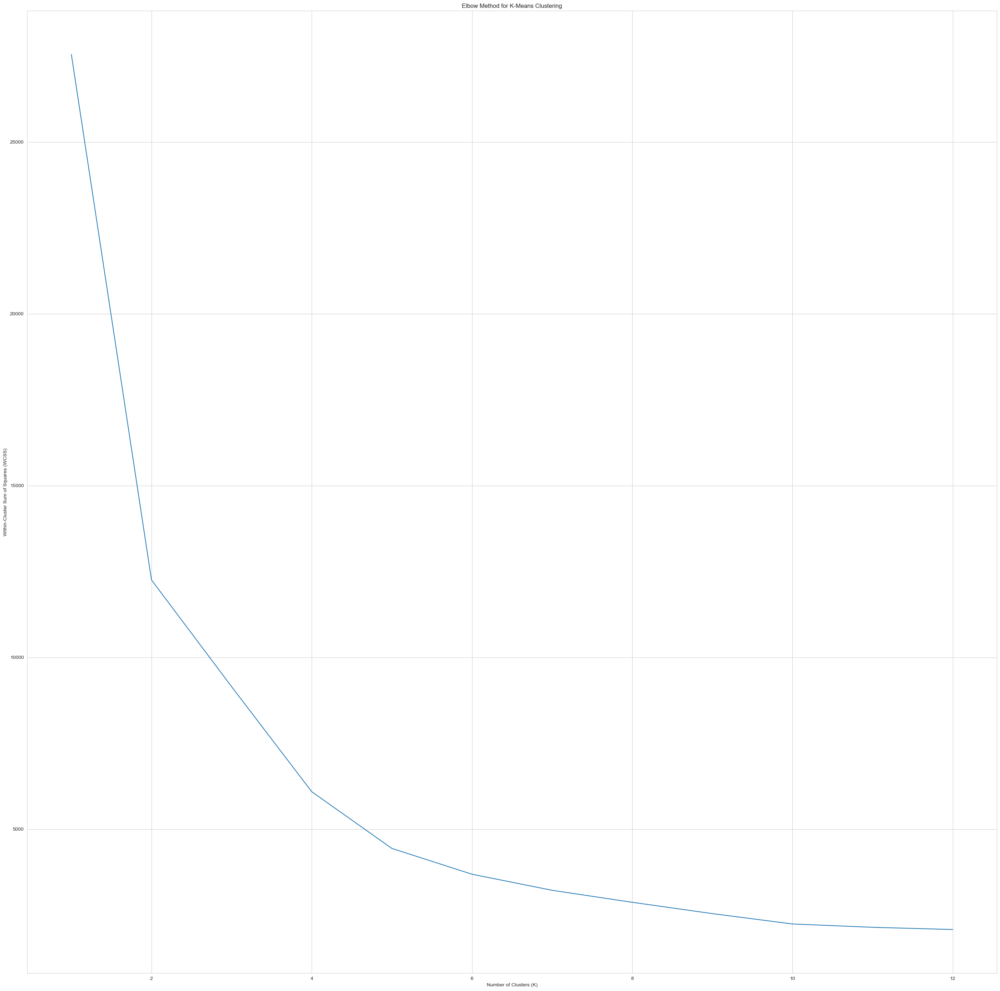

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

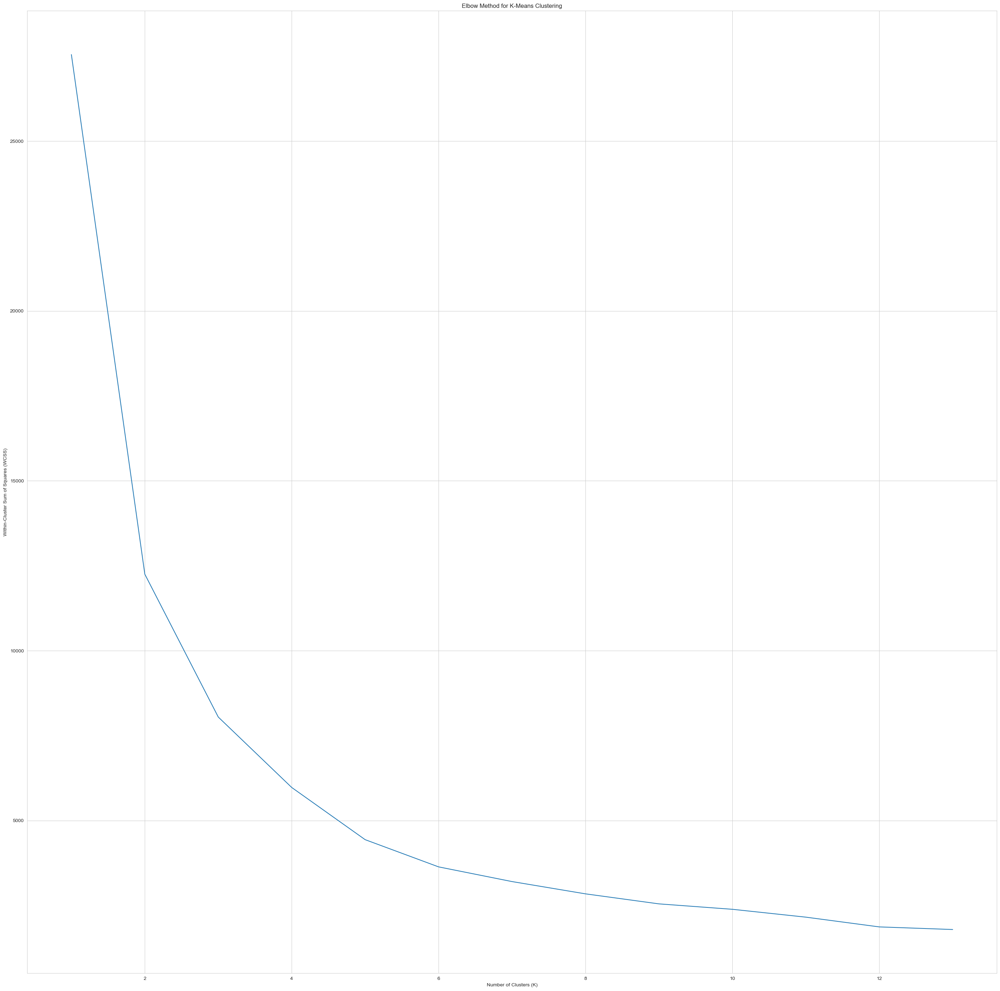

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

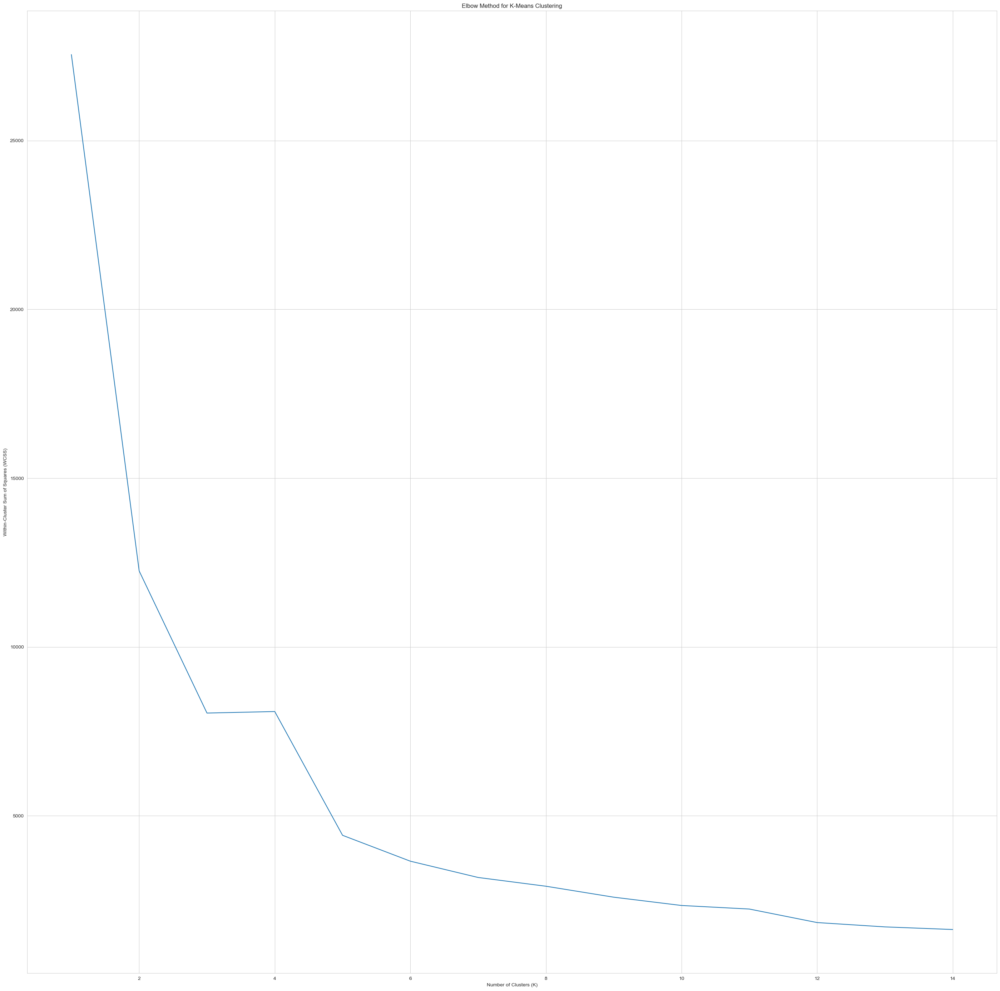

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

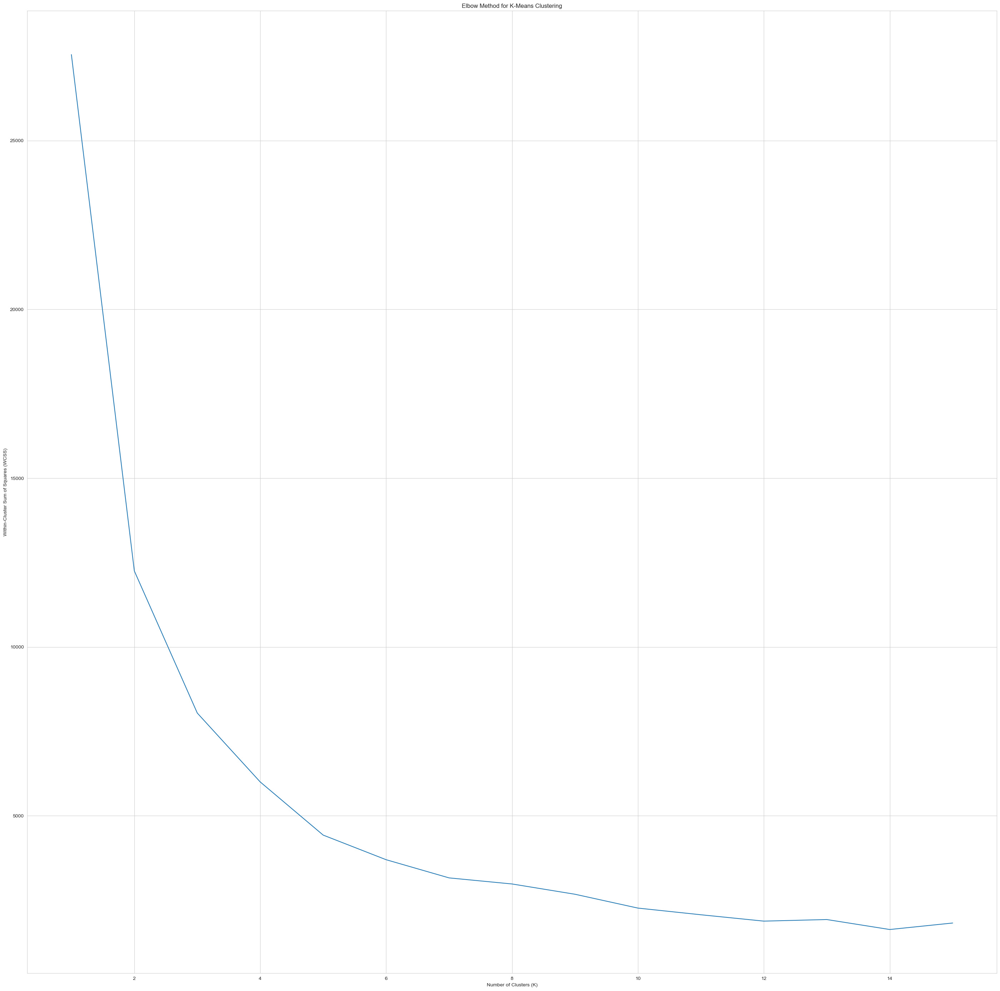

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

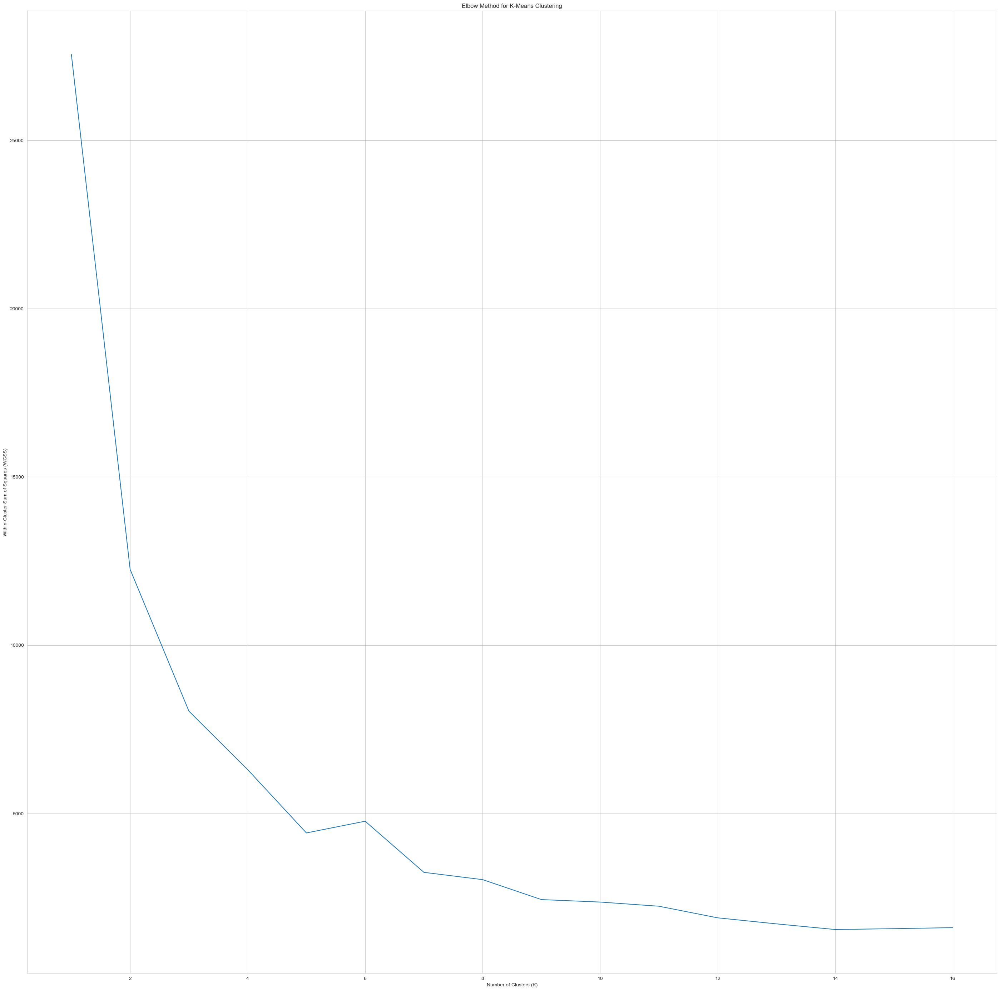

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

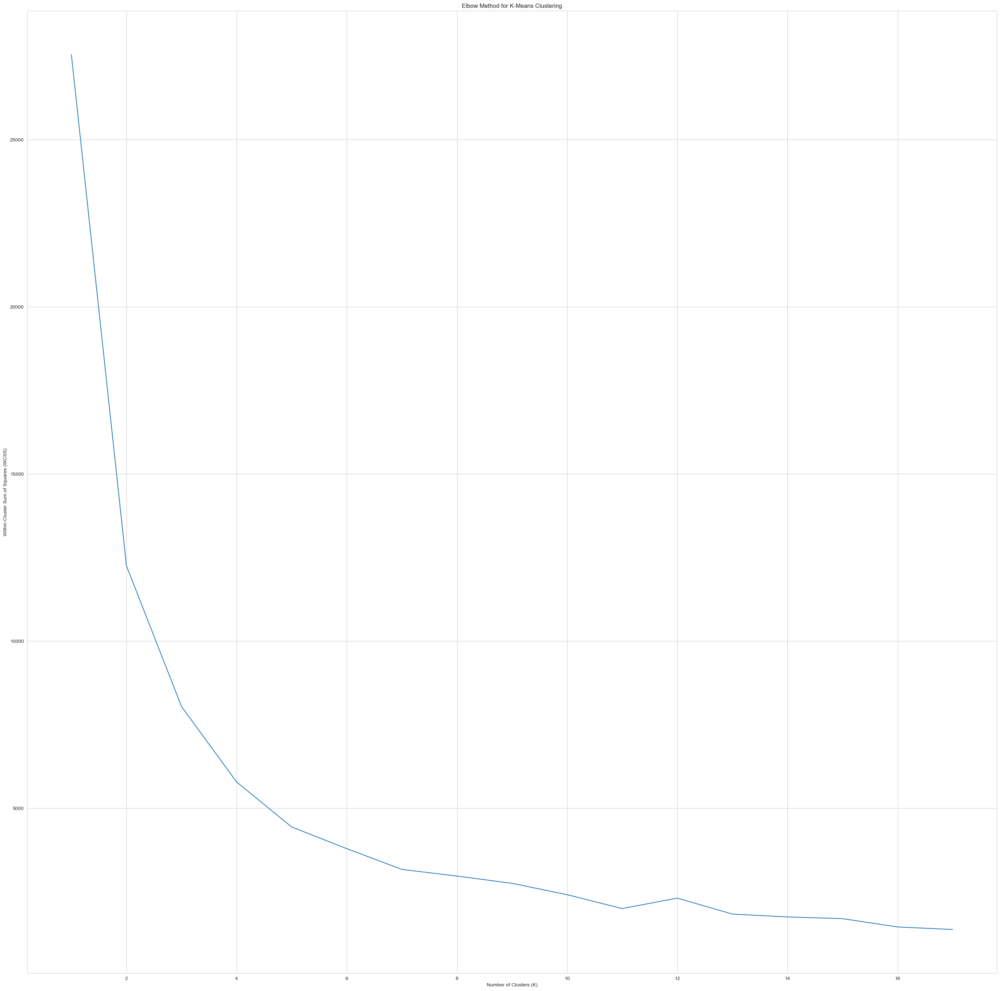

K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means it

KeyboardInterrupt: 

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

<Figure size 3500x3500 with 0 Axes>

In [134]:
for i in range(20):
    if i>5:
        l = list(np.arange(i))
        l.remove(0)
        elbow_method(X_nd_2,l)

<a name="4"></a>
## 4.Observations

1. After Observing the clusters trying to use number of clusters as 30 for the dataset the clustering of the state into districts we can observe that      the clustering is moderate at best.

2. Trying to use elbow method to find elbow point seems like a good method to optimise the cost function but that wouldn't help in gaining insights to the datset
   
3. Looking at the dataset more closely we have been given lattitudes and logitude locations in the dataset and there is a column containing office names in the dataset and another column indicating the type of office

4. After a quick google search I was able to find out that the following dataset contains latitude and longitude location of post offices all over India    

5. We will now try to observe the different types of post office in the state

In [135]:
karnataka_df

,DISTRICT,ST_NM,ST_CEN_CD,DT_CEN_CD,censuscode,geometry
32,Bagalkot,Karnataka,29,2,556,"POLYGON ((76.241 16.16531, 76.23538 16.13015, ..."
45,Bangalore Rural,Karnataka,29,29,583,"MULTIPOLYGON (((77.38701 13.50002, 77.40099 13..."
46,Bangalore,Karnataka,29,18,572,"POLYGON ((77.83549 12.86809, 77.83213 12.86372..."
65,Belgaum,Karnataka,29,1,555,"MULTIPOLYGON (((75.02647 16.93264, 75.02827 16..."
66,Bellary,Karnataka,29,11,565,"POLYGON ((77.15757 15.13706, 77.15887 15.12597..."
80,Bidar,Karnataka,29,4,558,"MULTIPOLYGON (((77.34032 18.43689, 77.3451 18...."
82,Bijapur,Karnataka,29,3,557,"POLYGON ((76.07344 17.33403, 76.0703 17.32251,..."
103,Chamrajnagar,Karnataka,29,24,578,"POLYGON ((77.32282 12.30709, 77.32726 12.30593..."
113,Chikkaballapura,Karnataka,29,28,582,"POLYGON ((78.1996 13.56615, 78.19897 13.56405,..."
114,Chikmagalur,Karnataka,29,16,570,"POLYGON ((76.35411 13.5777, 76.35611 13.57441,..."


In [143]:
filt_15 = data_k_nd['District'] == 'BIDAR'
data_k_bidar = data_k_nd[filt_15]

In [144]:
data_k_bidar

,CircleName,RegionName,DivisionName,OfficeName,Pincode,OfficeType,Delivery,District,StateName,Latitude,Longitude
429,Karnataka Circle,North Karnataka Region,Bidar Division,MANHALLI S.O,585447,PO,Delivery,BIDAR,KARNATAKA,17.8155,76.7971
430,Karnataka Circle,North Karnataka Region,Bidar Division,Aliabad B.O,585404,BO,Delivery,BIDAR,KARNATAKA,17.6258,78.5955
46682,Karnataka Circle,North Karnataka Region,Bidar Division,Ghotala B.O,585327,BO,Delivery,BIDAR,KARNATAKA,17.862654,76.787029
47918,Karnataka Circle,North Karnataka Region,Bidar Division,Jajanmugali B.O,585327,BO,Delivery,BIDAR,KARNATAKA,17.877693,76.752409
125579,Karnataka Circle,North Karnataka Region,Bidar Division,Bidar H.O,585401,HO,Delivery,BIDAR,KARNATAKA,17.91163889,77.51936111
138721,Karnataka Circle,North Karnataka Region,Bidar Division,Aurad (B) S.O,585326,PO,Delivery,BIDAR,KARNATAKA,18.252944,77.41566667
138722,Karnataka Circle,North Karnataka Region,Bidar Division,Bidar G.N.Jhira S.O,585402,PO,Delivery,BIDAR,KARNATAKA,17.907361,77.52713889
138723,Karnataka Circle,North Karnataka Region,Bidar Division,Bidar Gandhi Gunj S.O,585403,PO,Delivery,BIDAR,KARNATAKA,17.908639,77.51536111
138726,Karnataka Circle,North Karnataka Region,Bidar Division,Dubalgundi S.O,585418,PO,Delivery,BIDAR,KARNATAKA,17.911639,77.5193611
138727,Karnataka Circle,North Karnataka Region,Bidar Division,Hallikhed SF S.O,585415,PO,Delivery,BIDAR,KARNATAKA,17.911639,77.5193611


In [145]:
data_k_bidar.shape

(34, 11)

In [146]:
list_districts = list(karnataka_df['DISTRICT'])

In [174]:
def district_subset_df_creator(df,names):
    values = []
    keys = []
    for i in range(len(names)):
        filt = df['District'] == names[i].upper()
        subset_df = df[filt]
        if len(subset_df)!=0:
            values.append(subset_df)
            keys.append(names[i])
    return dict(zip(keys,values)),keys        

In [175]:
dict_df,list_names = district_subset_df_creator(data_k_nd,list_districts)

In [178]:
CHIKKABALLAPURA = dict_df.get(list_names[1])

In [179]:
CHIKKABALLAPURA

,CircleName,RegionName,DivisionName,OfficeName,Pincode,OfficeType,Delivery,District,StateName,Latitude,Longitude
57027,Karnataka Circle,South Karnataka Region,Kolar Division,Oolavadi B.O,563125,BO,Delivery,CHIKKABALLAPURA,KARNATAKA,13.3994221,78.0863121
59009,Karnataka Circle,South Karnataka Region,Kolar Division,Konapalli B.O,563125,BO,Delivery,CHIKKABALLAPURA,KARNATAKA,13.4106767,78.022733
59010,Karnataka Circle,South Karnataka Region,Kolar Division,Mylandahalli B.O,563125,BO,Delivery,CHIKKABALLAPURA,KARNATAKA,13.3122825,78.0887583
59011,Karnataka Circle,South Karnataka Region,Kolar Division,N. Kothur B.O,563125,BO,Delivery,CHIKKABALLAPURA,KARNATAKA,13.4517788,78.0582026
59012,Karnataka Circle,South Karnataka Region,Kolar Division,Nadampalli B.O,563125,BO,Delivery,CHIKKABALLAPURA,KARNATAKA,13.5790121,78.0697039
...,...,...,...,...,...,...,...,...,...,...,...
142362,Karnataka Circle,South Karnataka Region,Kolar Division,Hossur S.O,561210,PO,Delivery,CHIKKABALLAPURA,KARNATAKA,13.587139,77.4374444
142363,Karnataka Circle,South Karnataka Region,Kolar Division,MANCHENAHALLI S.O,561211,PO,Delivery,CHIKKABALLAPURA,KARNATAKA,13.506083,77.6033056
142364,Karnataka Circle,South Karnataka Region,Kolar Division,Sidlaghatta S.O,562105,PO,Delivery,CHIKKABALLAPURA,KARNATAKA,13.390944,77.8651667
142365,Karnataka Circle,South Karnataka Region,Kolar Division,Murugamale S.O,563146,PO,Delivery,CHIKKABALLAPURA,KARNATAKA,13.135639,78.1342222


In [185]:
filt_16 = data_k_nd['OfficeType'] == 'HO'
data_k_nd[filt_16]

,CircleName,RegionName,DivisionName,OfficeName,Pincode,OfficeType,Delivery,District,StateName,Latitude,Longitude
121319,Karnataka Circle,Bengaluru HQ Region,BANGALORE GPO DIVISION,Bengaluru G.P.O.,560001,HO,Delivery,BENGALURU URBAN,KARNATAKA,12.971599,77.594563
121561,Karnataka Circle,Bengaluru HQ Region,Bengaluru South Division,Basavanagudi H.O,560004,HO,Delivery,BENGALURU URBAN,KARNATAKA,12.9454166,77.5734762
121761,Karnataka Circle,North Karnataka Region,Gadag Division,Gadag H.O,582101,HO,Delivery,GADAG,KARNATAKA,15.4328056,75.6361389
122235,Karnataka Circle,South Karnataka Region,Puttur Division,Karkala H.O,574104,HO,Delivery,UDUPI,KARNATAKA,13.2145833,74.9965278
122572,Karnataka Circle,Bengaluru HQ Region,Bengaluru West Division,Jalahalli H.O,560013,HO,Delivery,BENGALURU URBAN,KARNATAKA,13.051064,77.552897
122620,Karnataka Circle,South Karnataka Region,Udupi Division,Manipal HO,576104,HO,Delivery,UDUPI,KARNATAKA,13.3489167,74.7860833
122621,Karnataka Circle,North Karnataka Region,Sirsi Division,Sirsi H.O,581401,HO,Delivery,UTTARA KANNADA,KARNATAKA,14.618606,74.829809
122622,Karnataka Circle,South Karnataka Region,Udupi Division,Kundapura HO,576201,HO,Delivery,UDUPI,KARNATAKA,13.63175,74.6918333
122725,Karnataka Circle,South Karnataka Region,Chikkamagaluru Division,Koppa H.O,577126,HO,Delivery,CHIKKAMAGALURU,KARNATAKA,13.5343611,75.3658611
122726,Karnataka Circle,South Karnataka Region,Puttur Division,Puttur(D.K.) H.O,574201,HO,Delivery,DAKSHINA KANNADA,KARNATAKA,12.7512222,75.2000556


## Let's try to take the number of Clusters as 53 and try to see if the form centroids are near HO locations

K-Means iteration 0/9


C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = plt.cm.get_cmap('tab20')  # Use a colormap with at least K distinct colors
C:\Users\Shriram Pragsh M\AppData\Local\Temp\ipykernel_20192\2923400825.py:21: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(data[:, 1], data[:, 0], label=f"Centroid {i+1}", c=colors[i])


K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means it

C:\Shriram\Anaconda\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Shriram\Anaconda\Lib\site-packages\numpy\core\_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(


K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means iteration 6/9
K-Means iteration 7/9
K-Means iteration 8/9
K-Means iteration 9/9
K-Means iteration 0/9
K-Means iteration 1/9
K-Means iteration 2/9
K-Means iteration 3/9
K-Means iteration 4/9
K-Means iteration 5/9
K-Means it

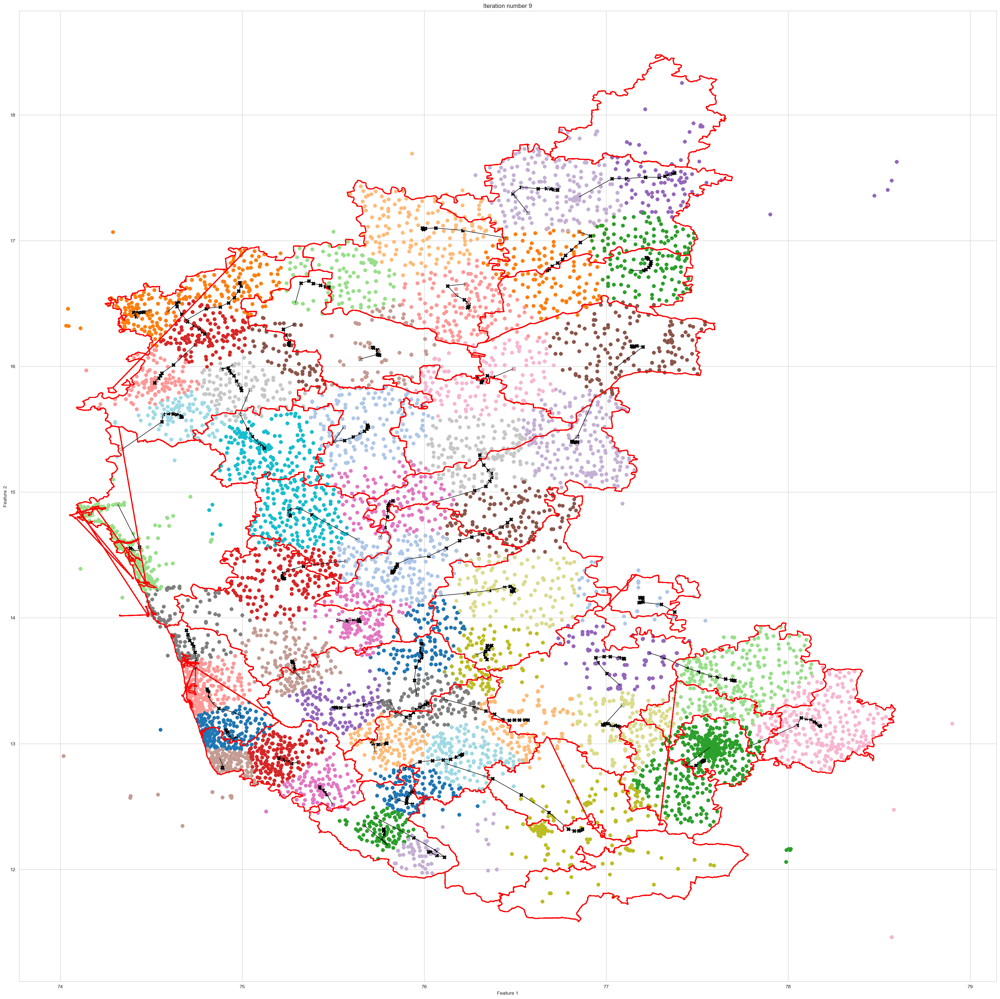

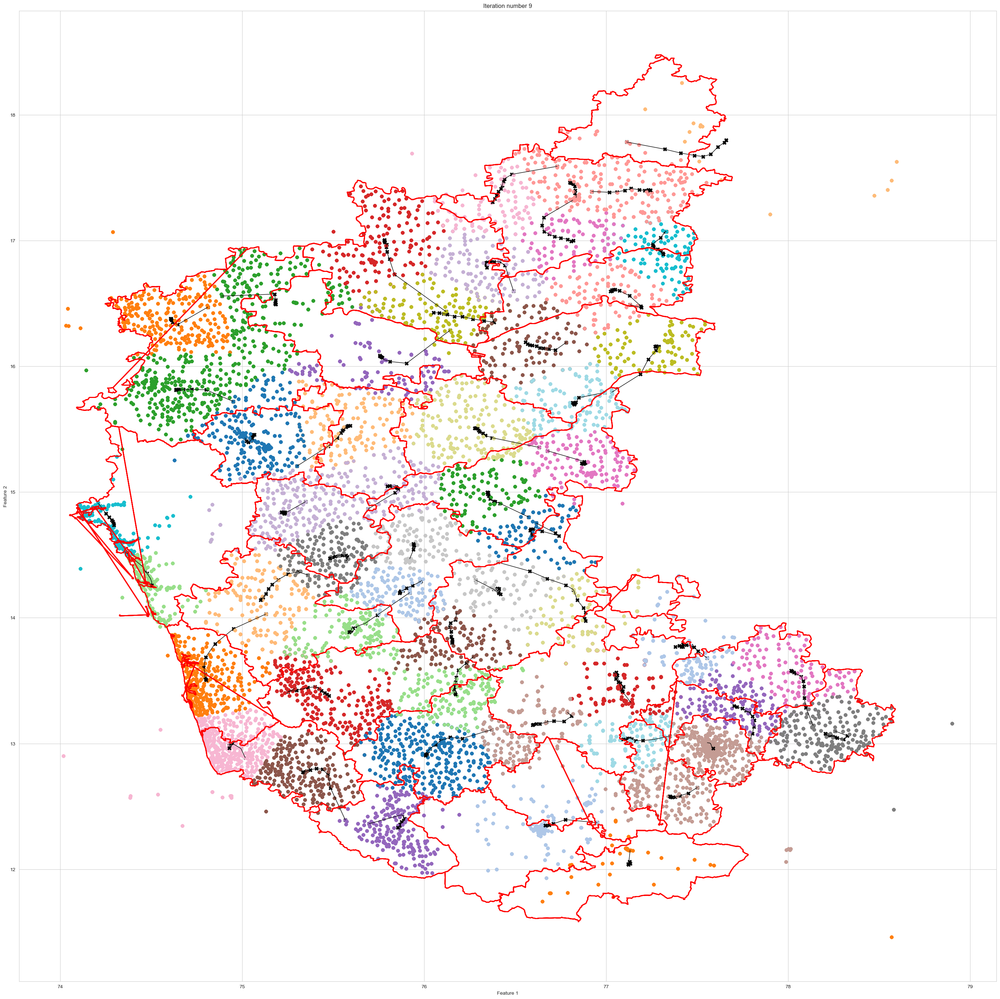

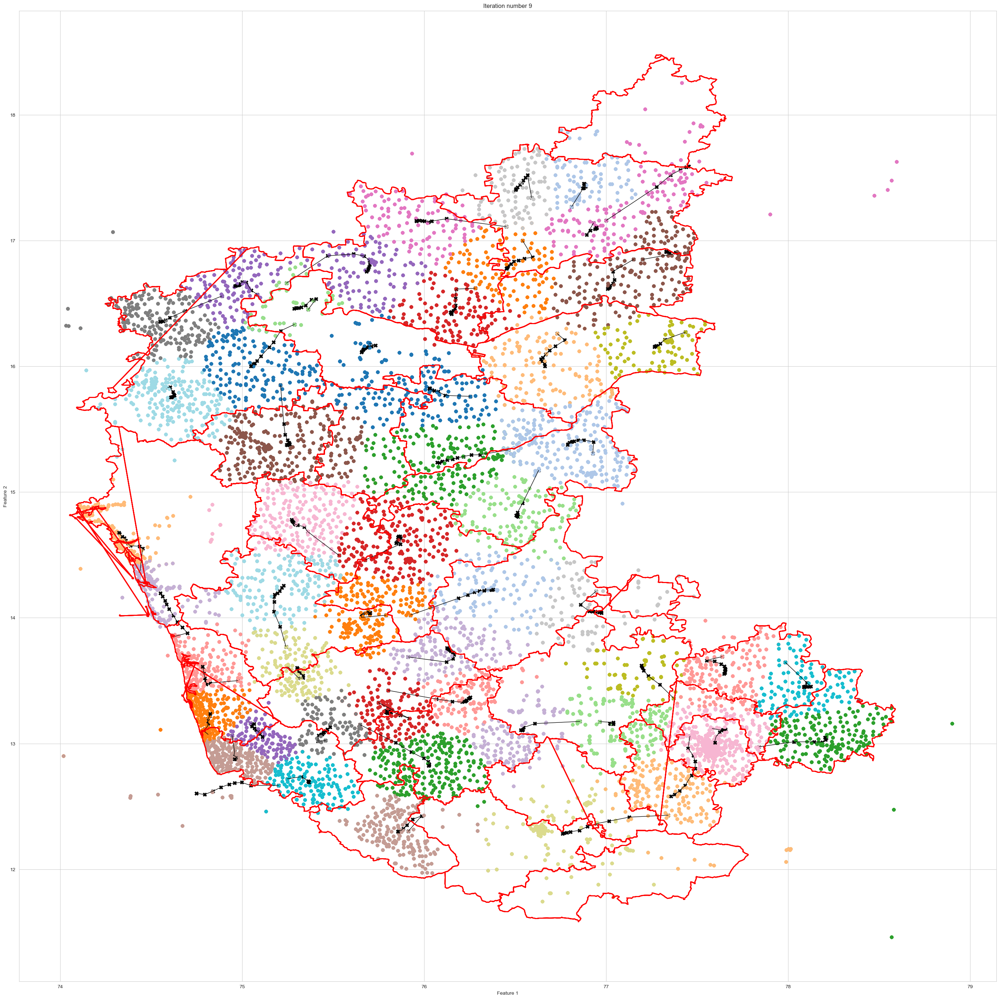

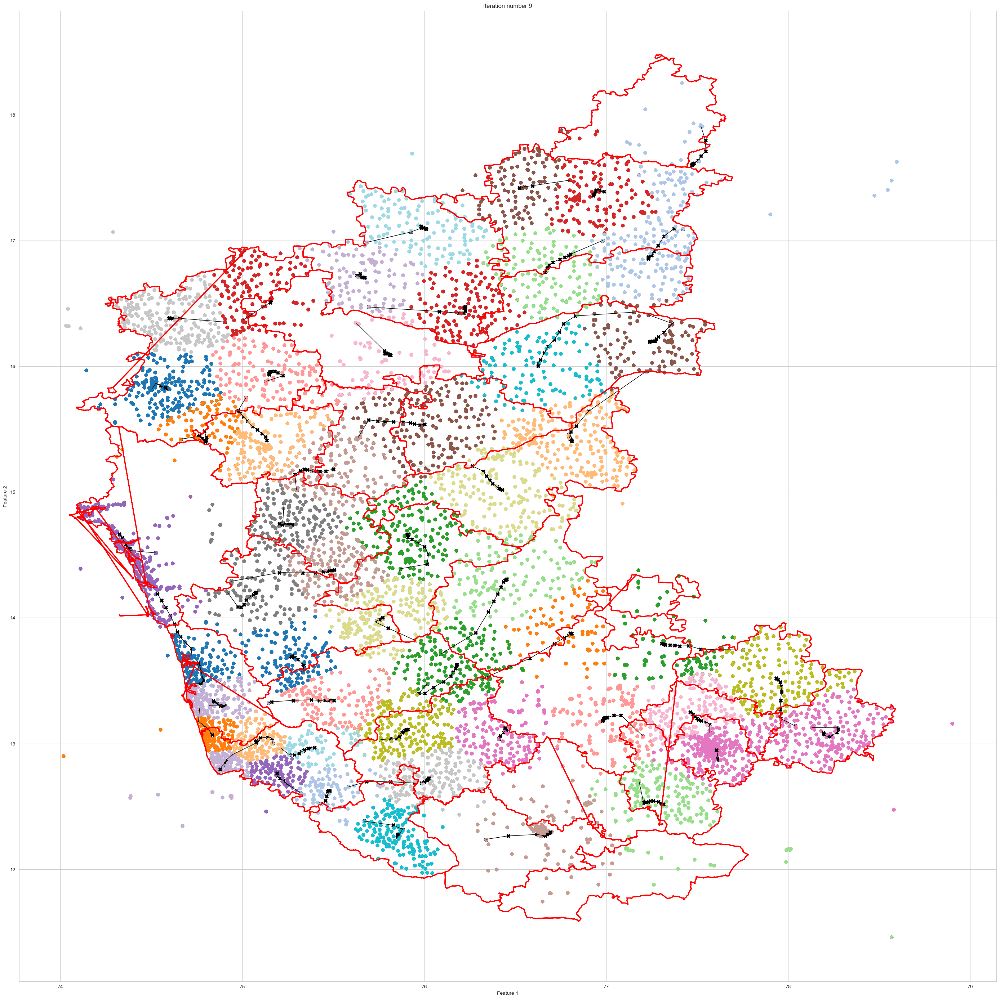

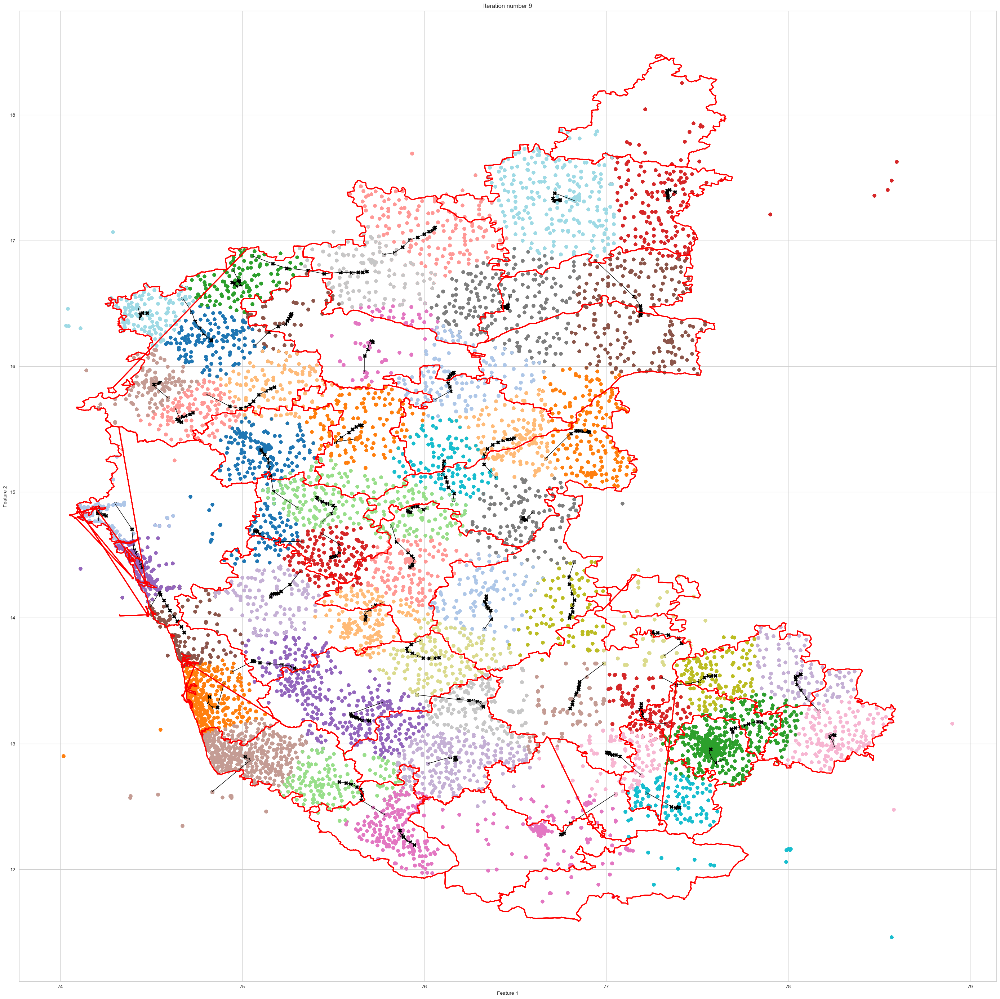

...

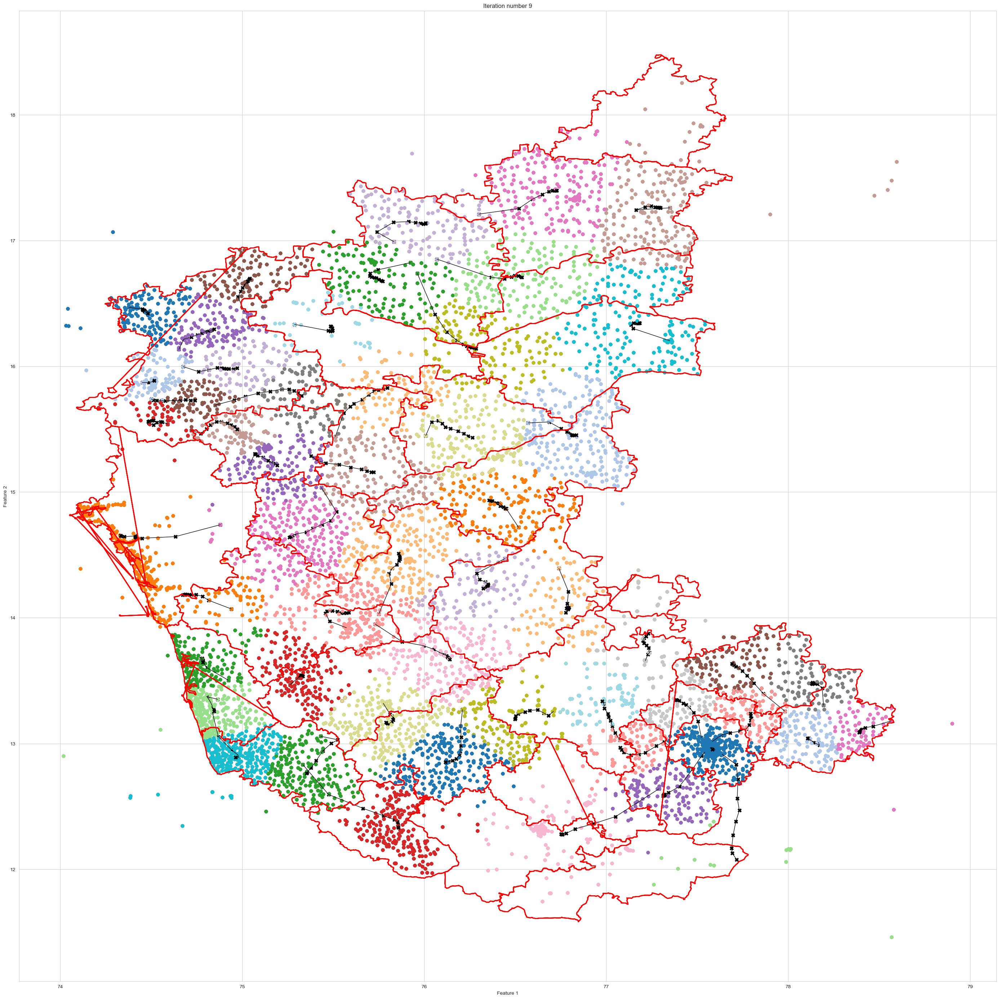

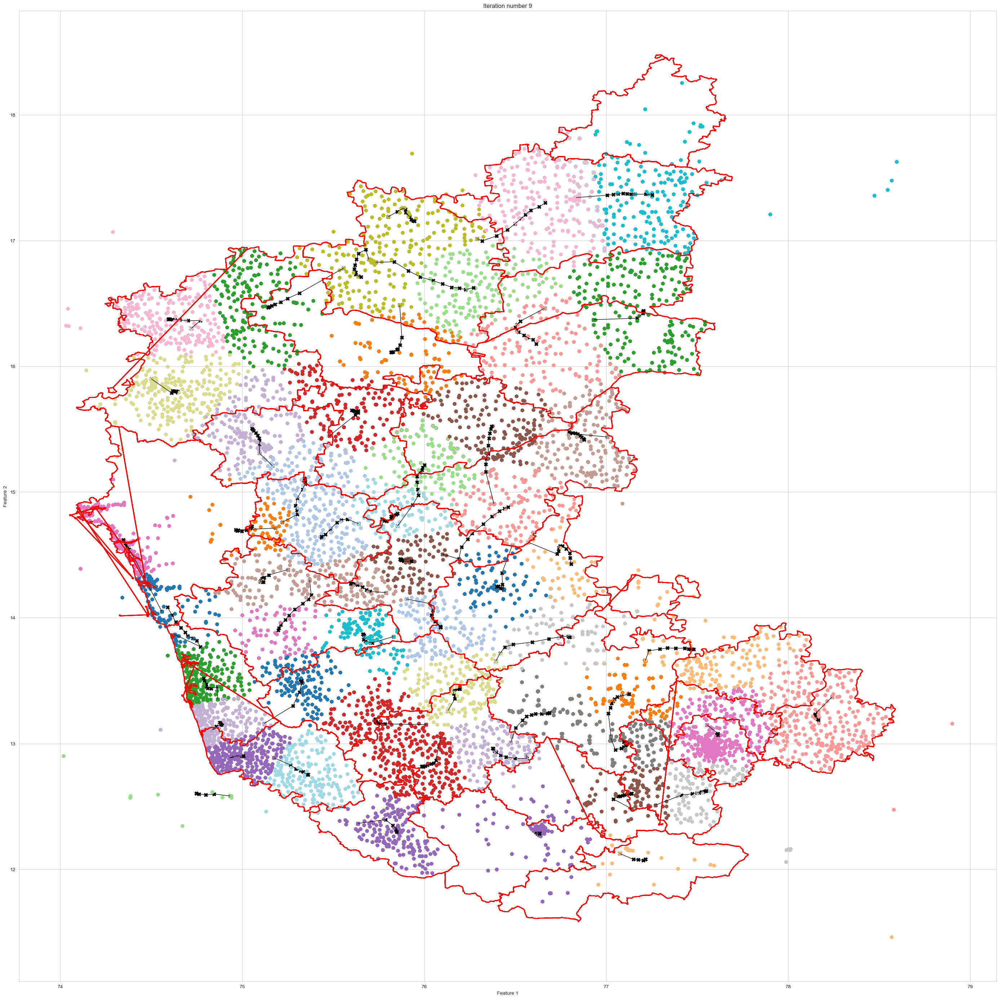

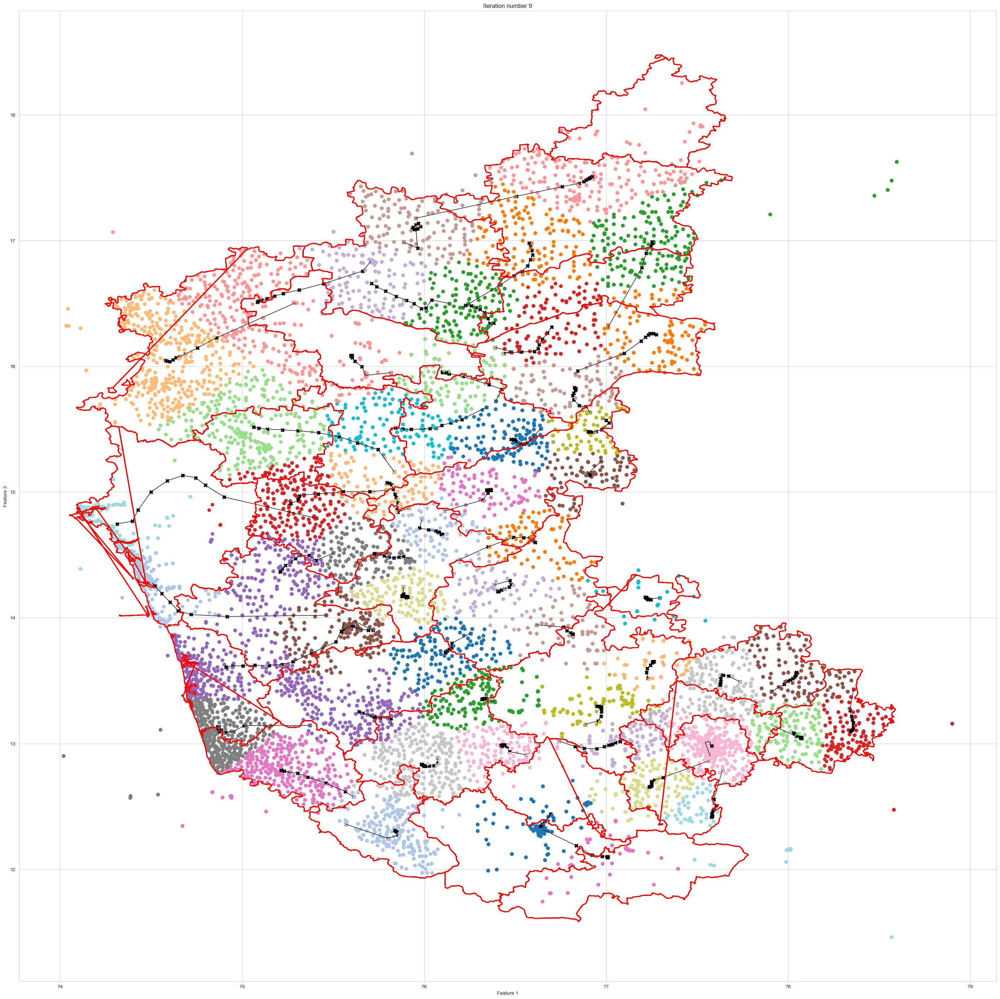

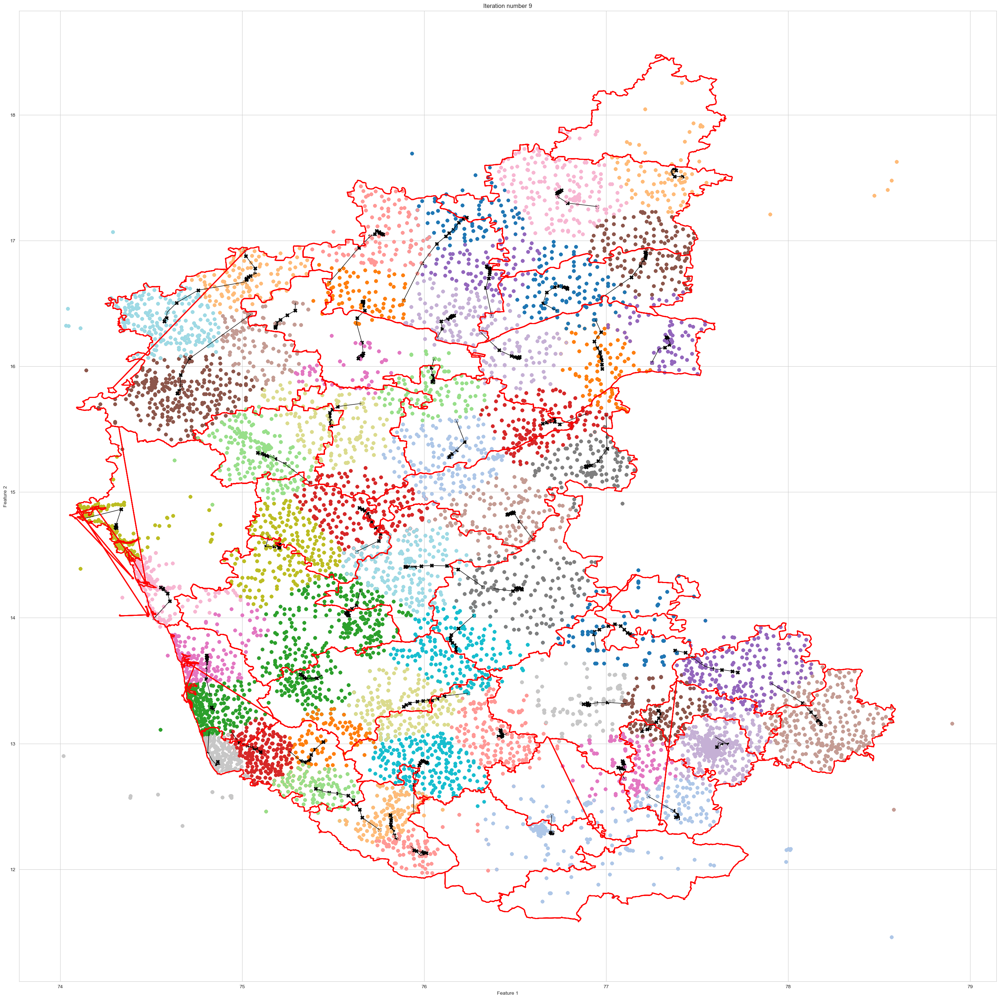

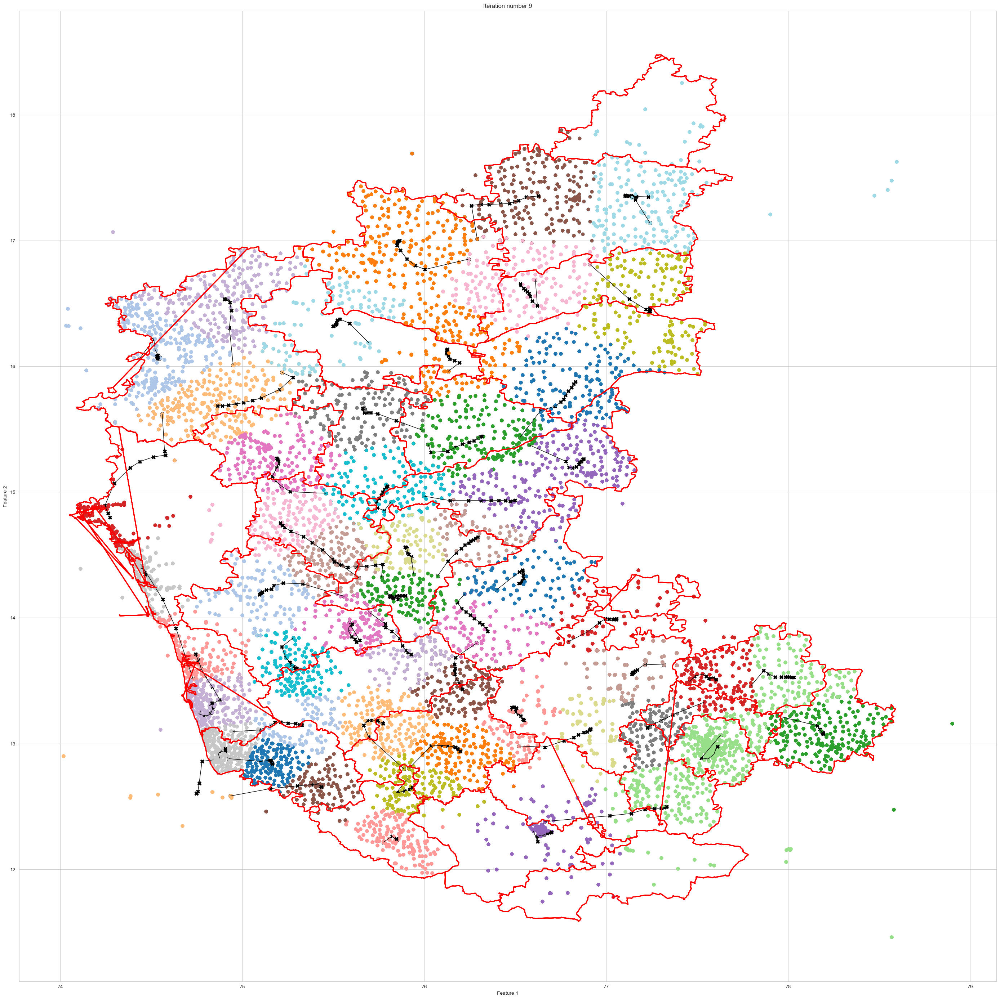

In [189]:
results_a_2 = Run_K_Means_iterate(20,53)

In [201]:
cost = []
for i in range(len(results_a_2)):
    x = results_a_2[i].get('cost')
    cost.append(x)
cost_np = np.array(cost)    
l_i = np.argmin(cost_np)    
print(l_i)    

18


In [200]:
print(cost)

[412.88912422714196, 396.69999809682975, 392.5261648777965, 403.03761658366034, 405.234357404155, 430.81598343963316, 27547.64485787932, 406.07738633921605, 397.2288520329754, 409.00258475302286, 27547.64485787932, 391.0882179667024, 410.06870219058607, 399.959635100804, 397.4522213272915, 426.9498954828822, 431.51709707865416, 438.11393887719424, 389.91050248048606, 432.1282720712472]


In [203]:
cent_l_c = results_a_2[18].get('centroids')